In [1]:
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import cm, colors
#from gprofiler import gprofiler

import os

# Define the path to the directory you want to change to
new_directory = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/MM_sysVI'

# Use os.chdir() to change the working directory
os.chdir(new_directory)

In [2]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [3]:
plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=12) #color_map=mymap2)
sc.settings.figdir = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/MM_sysVI/figures/'
sc.logging.print_header()

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


# MG lineage

In [4]:
adata = sc.read_h5ad('/scratch365/eaboelno/BACKUP_h5ad_IMPORTANT/adata_mm_MG_fine_type_WORKING.h5ad')
adata

AnnData object with n_obs × n_vars = 52981 × 19308
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'S_score', 'G2M_score', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'cluster_annotation', 'cell_leiden_annotated', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2', 'leiden_MG_r0.5', 'leiden_MG_r0.7', 'leiden_MG_r1', 'leiden_MG_r0.3', 'minimal_treatment_map', 'MG_type_fine', 'MG_leiden_annotated', 'NEW_treatment_map', 'individual_lesion_condition', 'MG_type_broad', 'MG_type_fine_reduced', 'MG_type_fine_NEW', 'MG_type_fine_NEW_NUMBERED', 'MG_type_fine_NUMBERED', 'MG_type_fine_LETTER'
   

In [5]:
today='_Dec16'

In [6]:
# Define the desired order of cell types in the legend
desired_order = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'Microglia_D', 'Microglia_E', 'Microglia_F', 'cycl_Microglia']

# Reorder the categories in the 'cell_type_fine_mm' column of adata_ol_ol
adata.obs['MG_type_fine_NEW'] = pd.Categorical(adata.obs['MG_type_fine_NEW'], 
                                                    categories=desired_order, 
                                                    ordered=True)

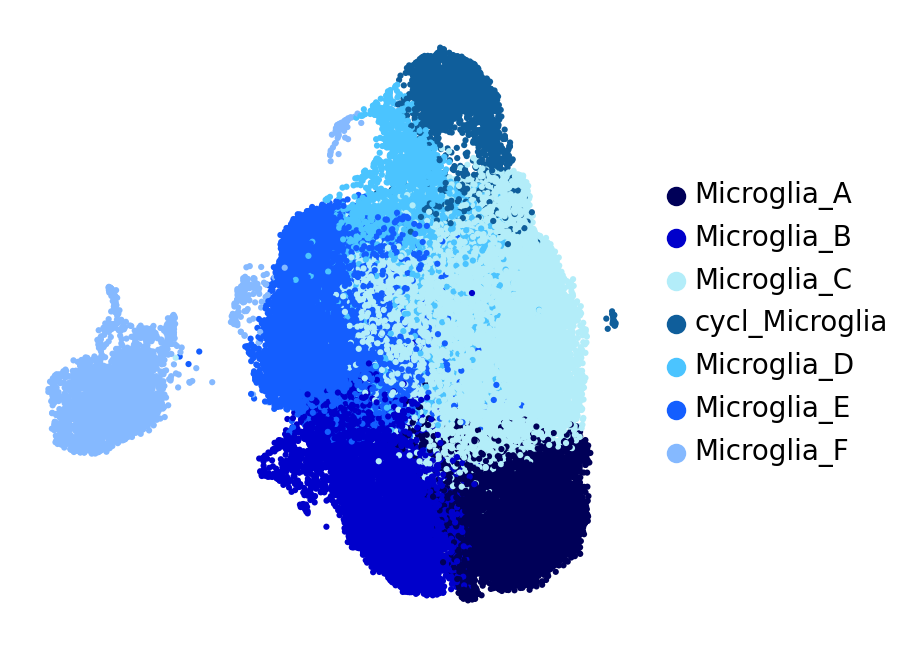

In [6]:
cluster_color = {     
    'cycl_Microglia': '#0f5e9b',  
    'Microglia_A': '#000058',    
    'Microglia_B': '#0000cb',
    'Microglia_C': '#b3edf9',
    'Microglia_D': '#4bc4ff',  
    'Microglia_E': '#145eff', 
    'Microglia_F': '#85b9ff', 
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['MG_type_fine_NEW'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='',
           legend_fontweight= 'bold', frameon= False, s=20, 
           legend_fontoutline=1)# save=today+'_MG.png')

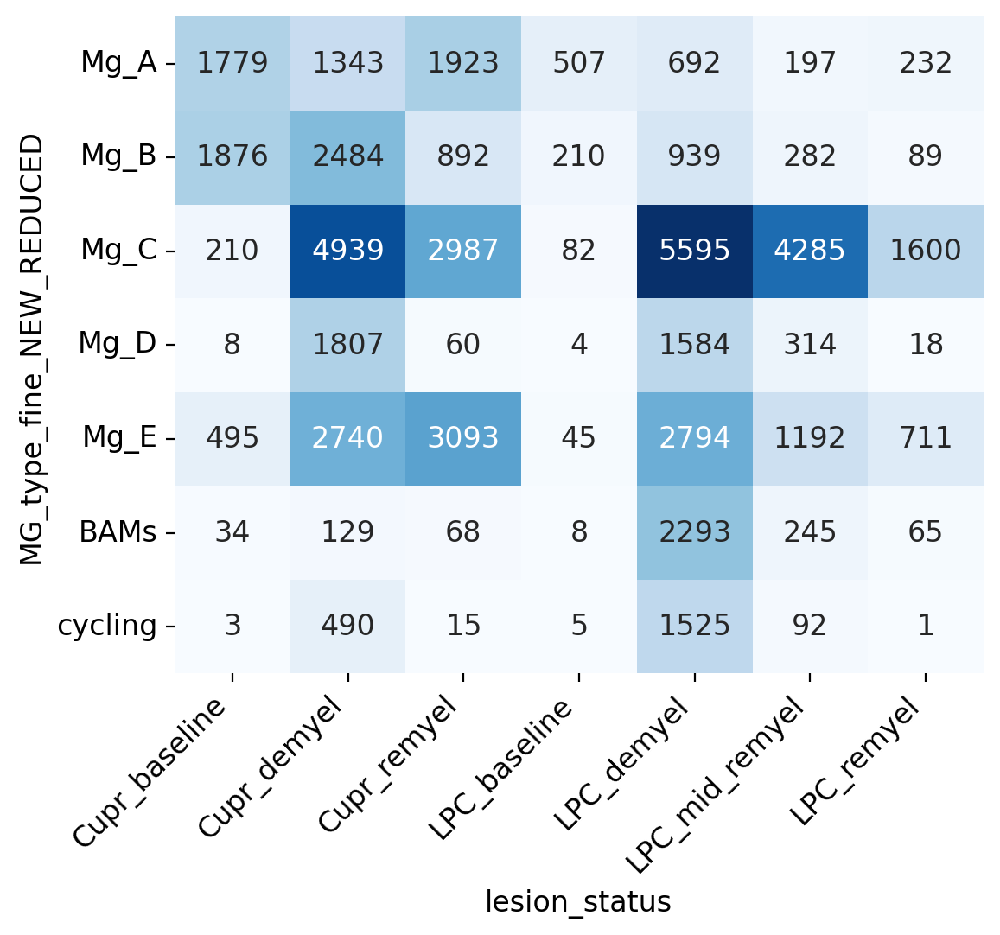

In [11]:
plt.figure(figsize=(6, 5))
crosstab_df = pd.crosstab(adata.obs.MG_type_fine_NEW_REDUCED, adata.obs.lesion_status)

ax = sb.heatmap(crosstab_df, cmap='Blues', annot=True, fmt="d", cbar=False, annot_kws={"size": 12})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)
ax.grid(False)

# Show the heatmap
plt.show()

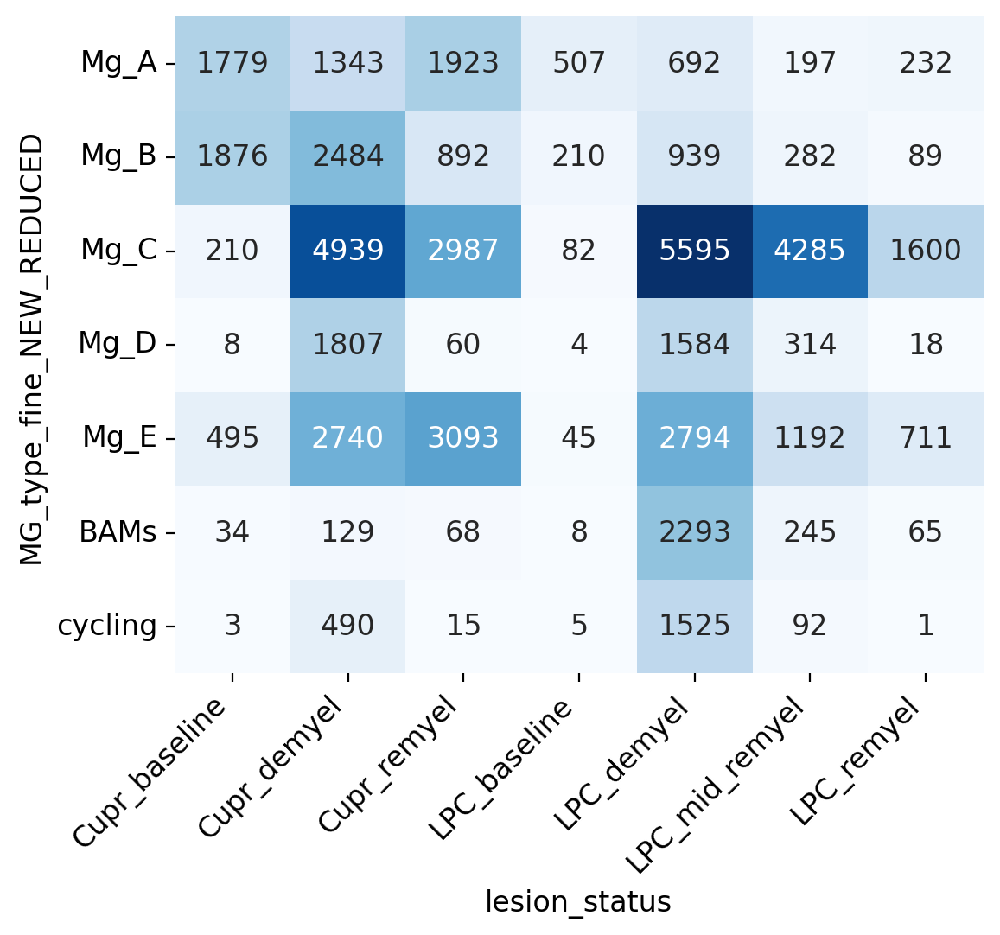

In [12]:
plt.figure(figsize=(6, 5))
crosstab_df = pd.crosstab(adata.obs.MG_type_fine_NEW_REDUCED, adata.obs.lesion_status)

ax = sb.heatmap(crosstab_df, cmap='Blues', annot=True, fmt="d", cbar=False, annot_kws={"size": 12})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)
ax.grid(False)

# Save the heatmap as a PNG file
output_path = "./figures/MG_crosstab_heatmap.png"  # Change the path and filename if needed
plt.savefig(output_path, dpi=300, bbox_inches="tight", transparent=True)

# Show the heatmap
plt.show()

In [7]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
    'cycl_Microglia': 'cycl_Microglia',  
    'Microglia_A': 'Microglia_A',    
    'Microglia_B': 'Microglia_B',
    'Microglia_C': 'Microglia_C',
    'Microglia_D': 'Microglia_D',  
    'Microglia_E': 'Microglia_E', 
    'Microglia_F': 'BAMs', 
}

adata.obs['MG_type_fine_BAM'] = adata.obs['MG_type_fine_NEW'].map(cell_type).astype('category')

In [8]:
# Define the desired order of cell types in the legend
desired_order = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'Microglia_D', 'Microglia_E', 'BAMs', 'cycl_Microglia']

# Reorder the categories in the 'cell_type_fine_mm' column of adata_ol_ol
adata.obs['MG_type_fine_BAM'] = pd.Categorical(adata.obs['MG_type_fine_BAM'], 
                                                    categories=desired_order, 
                                                    ordered=True)

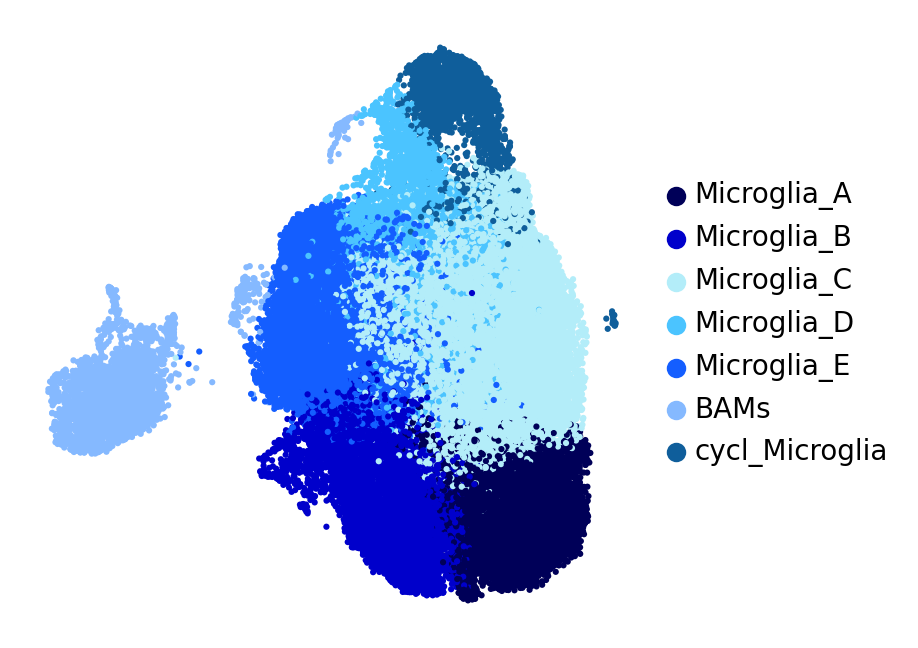

In [9]:
cluster_color = {     
    'cycl_Microglia': '#0f5e9b',  
    'Microglia_A': '#000058',    
    'Microglia_B': '#0000cb',
    'Microglia_C': '#b3edf9',
    'Microglia_D': '#4bc4ff',  
    'Microglia_E': '#145eff', 
    'BAMs': '#85b9ff', 
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['MG_type_fine_BAM'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='',
           legend_fontweight= 'bold', frameon= False, s=20, 
           legend_fontoutline=1, save=today+'_MG_BAMs.png')

In [9]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
    'cycl_Microglia': 'cycling',  
    'Microglia_A': 'Mg_A',    
    'Microglia_B': 'Mg_B',
    'Microglia_C': 'Mg_C',
    'Microglia_D': 'Mg_D',  
    'Microglia_E': 'Mg_E', 
    'BAMs': 'BAMs', 
}

adata.obs['MG_type_fine_NEW_REDUCED'] = adata.obs['MG_type_fine_BAM'].map(cell_type).astype('category')

In [10]:
# Define the desired order of cell types in the legend
desired_order = ['Mg_A', 'Mg_B', 'Mg_C', 'Mg_D', 'Mg_E', 'BAMs', 'cycling']

# Reorder the categories in the 'cell_type_fine_mm' column of adata_ol_ol
adata.obs['MG_type_fine_NEW_REDUCED'] = pd.Categorical(adata.obs['MG_type_fine_NEW_REDUCED'], 
                                                    categories=desired_order, 
                                                    ordered=True)

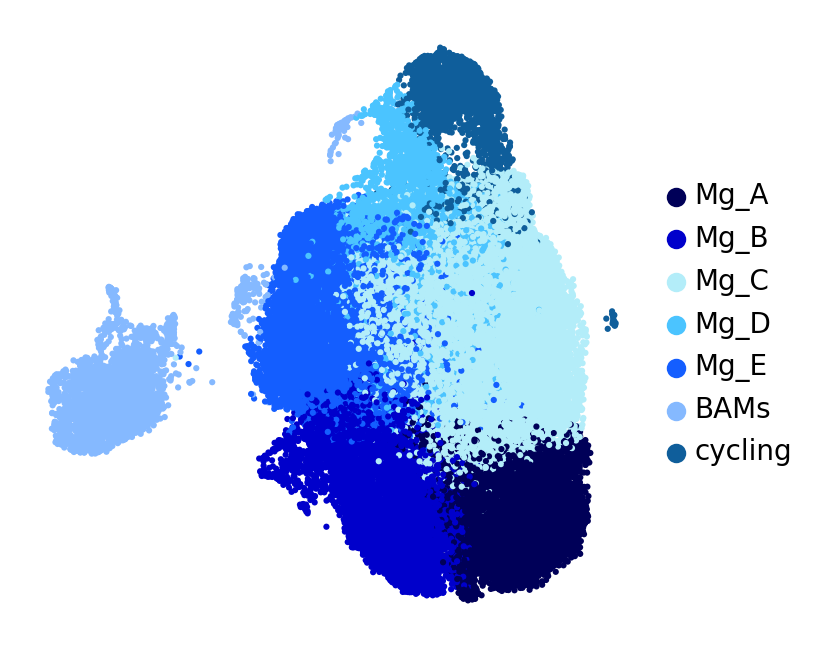

In [12]:
cluster_color = {     
    'cycling': '#0f5e9b',  
    'Mg_A': '#000058',    
    'Mg_B': '#0000cb',
    'Mg_C': '#b3edf9',
    'Mg_D': '#4bc4ff',  
    'Mg_E': '#145eff', 
    'BAMs': '#85b9ff', 
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['MG_type_fine_NEW_REDUCED'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='',
           legend_fontweight= 'bold', frameon= False, s=20, 
           legend_fontoutline=1, save=today+'_MG_reduced.png')

In [13]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
    'cycl_Microglia': 'cycl',  
    'Microglia_A': 'A',    
    'Microglia_B': 'B',
    'Microglia_C': 'C',
    'Microglia_D': 'D',  
    'Microglia_E': 'E', 
    'BAMs': 'BAMs', 
}

adata.obs['MG_type_fine_LETTER'] = adata.obs['MG_type_fine_BAM'].map(cell_type).astype('category')

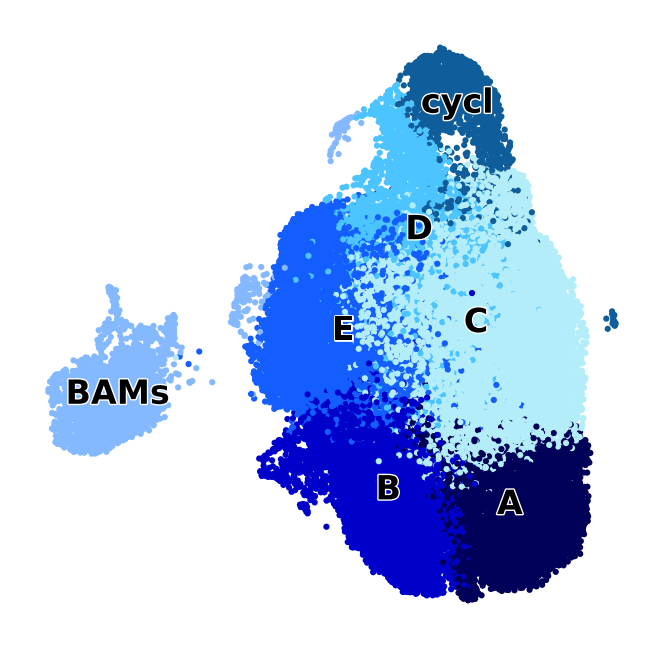

In [14]:
cluster_color = {     
    'cycl': '#0f5e9b',  
    'A': '#000058',    
    'B': '#0000cb',
    'C': '#b3edf9',
    'D': '#4bc4ff',  
    'E': '#145eff', 
    'BAMs': '#85b9ff', 
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['MG_type_fine_LETTER'], legend_fontsize =float(12) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='', legend_loc='on data',
           legend_fontweight= 'bold', frameon= False, s=20, 
           legend_fontoutline=1, save=today+'_MG_lettered.png')

In [15]:
# Unique values in the 'condition' column
unique_conditions = adata.obs['lesion_status'].unique()
for condition in unique_conditions:
    print(condition)

LPC_demyel
LPC_baseline
Cupr_demyel
Cupr_baseline
LPC_remyel
LPC_mid_remyel
Cupr_remyel


In [16]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata.obs.groupby(['lesion_status', 'MG_type_fine_NEW_REDUCED']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='MG_type_fine_NEW_REDUCED', columns='lesion_status', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/1030622.1.gpu/ipykernel_2298322/2782846402.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata.obs.groupby(['lesion_status', 'MG_type_fine_NEW_REDUCED']).size().reset_index(name='cell_count')


MG_type_fine_NEW_REDUCED,Mg_A,Mg_B,Mg_C,Mg_D,Mg_E,BAMs,cycling
lesion_status,,,,,,,
Cupr_baseline,40.385925,42.587968,4.767310,0.181612,11.237230,0.771850,0.068104
Cupr_demyel,9.639678,17.829457,35.450761,12.970141,19.666954,0.925926,3.517083
Cupr_remyel,21.276831,9.869440,33.049347,0.663864,34.222173,0.752379,0.165966
LPC_baseline,58.885017,24.390244,9.523810,0.464576,5.226481,0.929152,0.580720
LPC_demyel,4.487096,6.088704,36.279341,10.271041,18.116976,14.868370,9.888471
LPC_mid_remyel,2.981686,4.268200,64.855456,4.752535,18.041471,3.708188,1.392463
LPC_remyel,8.541973,3.276878,58.910162,0.662739,26.178203,2.393225,0.036819


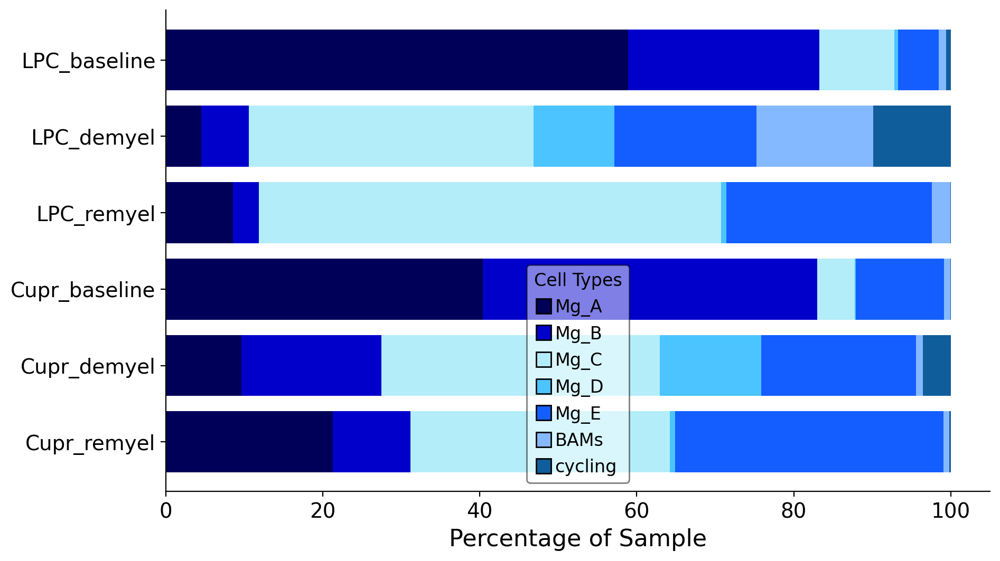

In [19]:
# Define the desired order of treatments and cell types
desired_treatments_order = ['LPC_baseline', 'LPC_demyel', 'LPC_mid_remyel', 'LPC_remyel',
                            'Cupr_baseline', 'Cupr_demyel', 'Cupr_remyel']
    
desired_cell_types_order = ['Mg_A', 'Mg_B', 'Mg_C', 'Mg_D', 
                            'Mg_E', 'BAMs', 'cycling']

# Reorder the columns and the index of the percent_counts DataFrame
percent_counts_reordered = percent_counts_transposed[desired_cell_types_order].reindex(desired_treatments_order)

# Reorder the columns of the DataFrame with the 'other' category included
desired_cell_types_order_updated = ['Mg_A', 'Mg_B', 'Mg_C', 'Mg_D', 
                            'Mg_E', 'BAMs', 'cycling']

# Remove the specific row from the DataFrame
percent_counts_reordered.drop(index='LPC_mid_remyel', inplace=True)

#Rename index
percent_counts_reordered.rename(index={'LPC_mid_remyel': 'LPC_mid_remyel'}, inplace=True)

percent_counts_reordered = percent_counts_reordered[desired_cell_types_order_updated]

# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'cycling': '#0f5e9b',  
    'Mg_A': '#000058',    
    'Mg_B': '#0000cb',
    'Mg_C': '#b3edf9',
    'Mg_D': '#4bc4ff',  
    'Mg_E': '#145eff', 
    'BAMs': '#85b9ff', 
}

# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_reordered.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Create legend with transparency
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_reordered.columns]
legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower center', fontsize=12, title='Cell Types')

# Set transparency of the legend
legend.get_frame().set_alpha(0.5)  # Set alpha value for transparency (0.5 makes it semi-transparent)

# Optionally, add a border color for contrast
legend.get_frame().set_edgecolor('black')  # Set border color of the legend

# Save the plot as a PNG file
#plt.savefig('./sysVI_mm_MG_figures/MM_MG_cell_types_barh.png', bbox_inches='tight', dpi=300)  # Increase DPI for higher resolution

# Show the plot
plt.show()

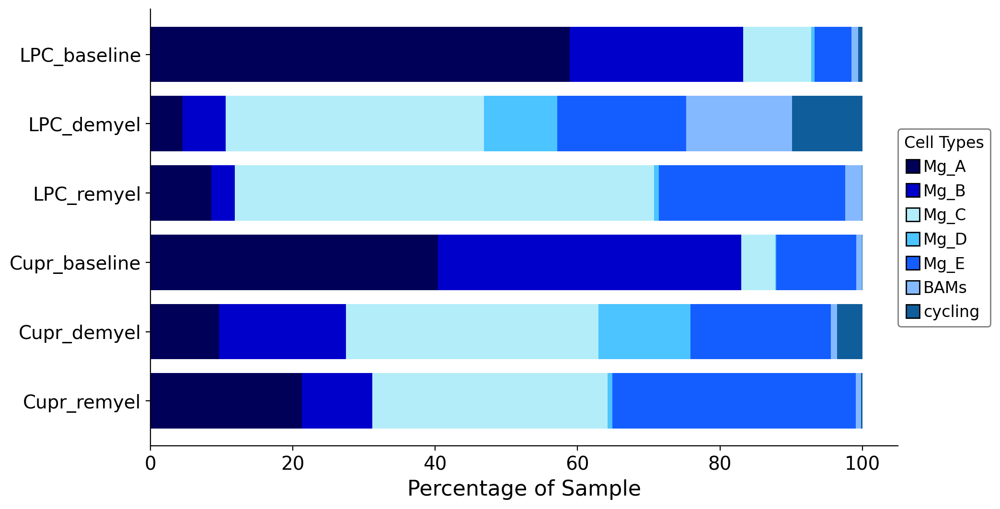

In [20]:
# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'cycling': '#0f5e9b',  
    'Mg_A': '#000058',    
    'Mg_B': '#0000cb',
    'Mg_C': '#b3edf9',
    'Mg_D': '#4bc4ff',  
    'Mg_E': '#145eff', 
    'BAMs': '#85b9ff', 
}

# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_reordered.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Create legend with transparency
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_reordered.columns]
#legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower center', fontsize=12, title='Cell Types')
legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='center left', fontsize=12, title='Cell Types', bbox_to_anchor=(1, 0.5), borderaxespad=0.)

# Set transparency of the legend
legend.get_frame().set_alpha(0.5)  # Set alpha value for transparency (0.5 makes it semi-transparent)

# Optionally, add a border color for contrast
legend.get_frame().set_edgecolor('black')  # Set border color of the legend

# Save the plot as a PNG file
plt.savefig('./figures/MM_MG_cell_types_barh_4.png', bbox_inches='tight', dpi=300)  # Increase DPI for higher resolution

# Show the plot
plt.show()

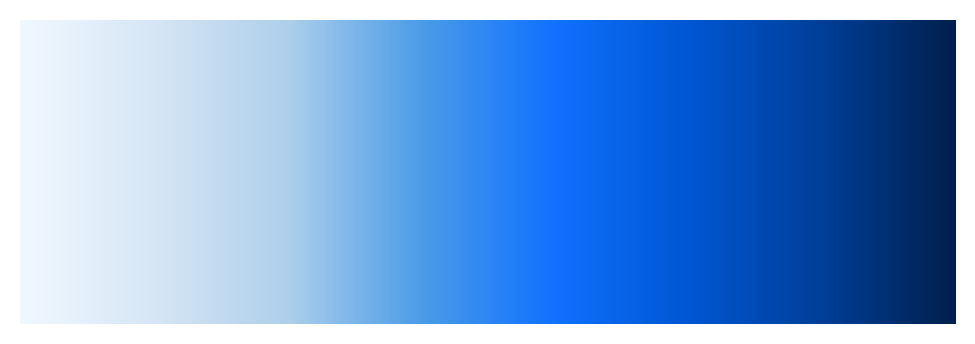

In [21]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt


# Define the custom blue colormap
blue_colors = ['#f0f8ff', '#d6e6f5', '#adcfeb', '#4b9ce7', '#1072ff', '#0057d4', '#003f99', '#00204d']
custom_blues = LinearSegmentedColormap.from_list('CustomBlues', blue_colors, N=512)

# Create a gradient for visualization
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))

# Plot the custom colormap
fig, ax = plt.subplots(figsize=(6, 2))

# Show the gradient with the custom colormap
ax.imshow(gradient, aspect='auto', cmap=custom_blues)

# Turn off the axes for a clean look
ax.set_axis_off()

# Show the plot
plt.show()

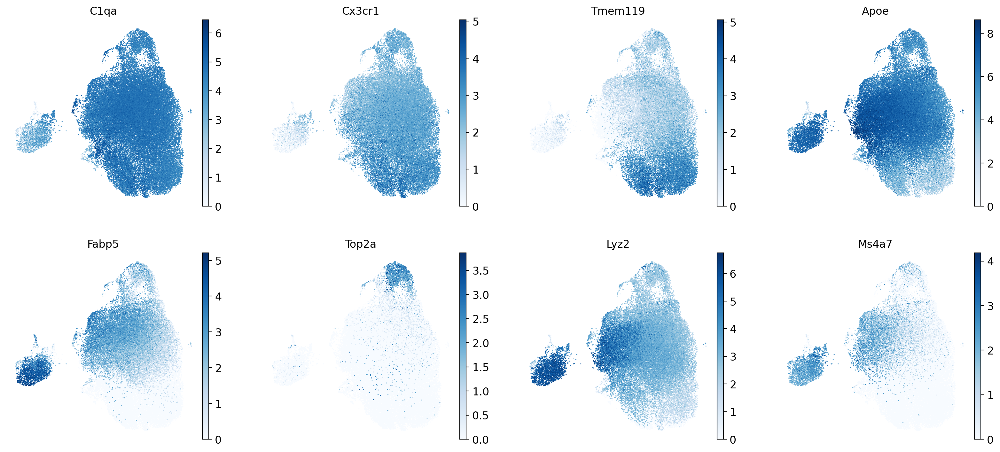

In [31]:
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=['C1qa','Cx3cr1', 'Tmem119', 'Apoe','Fabp5', 'Top2a',
          'Lyz2', 'Ms4a7'],
    frameon=False,
    ncols=4,
    s=5,
    use_raw=False,
    cmap='Blues',
    layer='log1p_norm',
    save='_mm_sysVI_MG_genes_POSTER.png'
)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_MG_type_fine_BAM']`


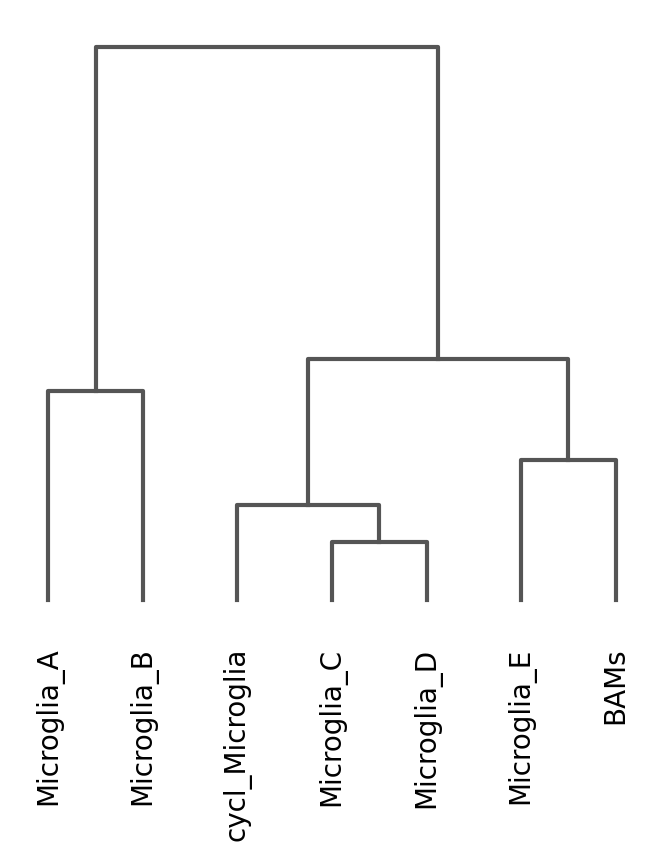

<Axes: >

In [22]:
sc.tl.dendrogram(adata, 'MG_type_fine_BAM')
sc.pl.dendrogram(adata, 'MG_type_fine_BAM')

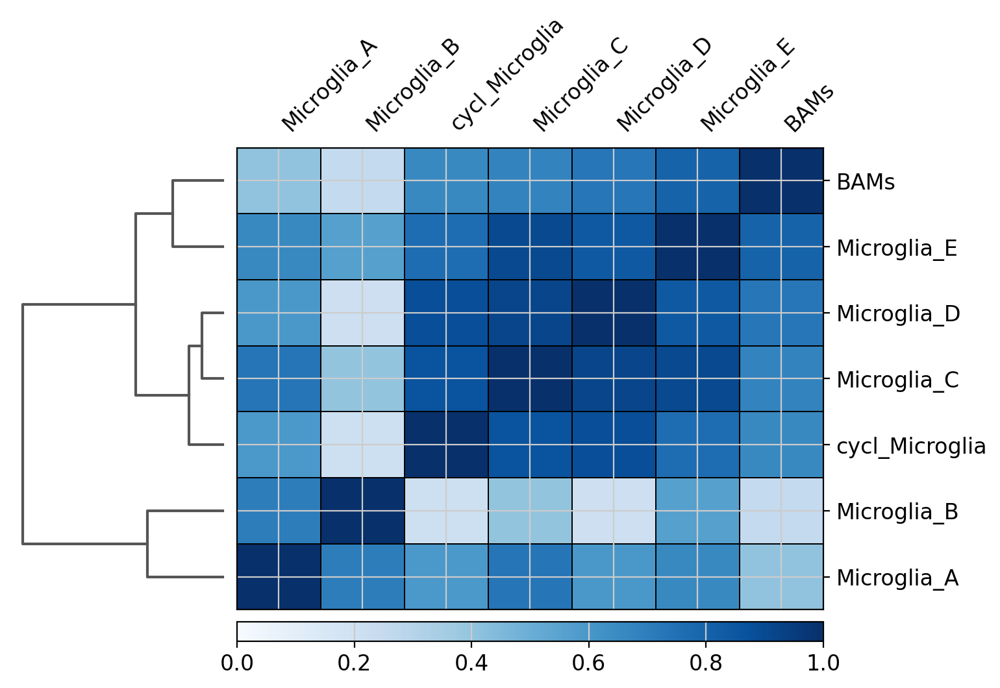

In [23]:
time='_Dec2'
ax = sc.pl.correlation_matrix(adata, "MG_type_fine_BAM", figsize=(8, 5),color='black', vmin=0, 
                              cmap='Blues', save=time+'correlation_matrix.png')

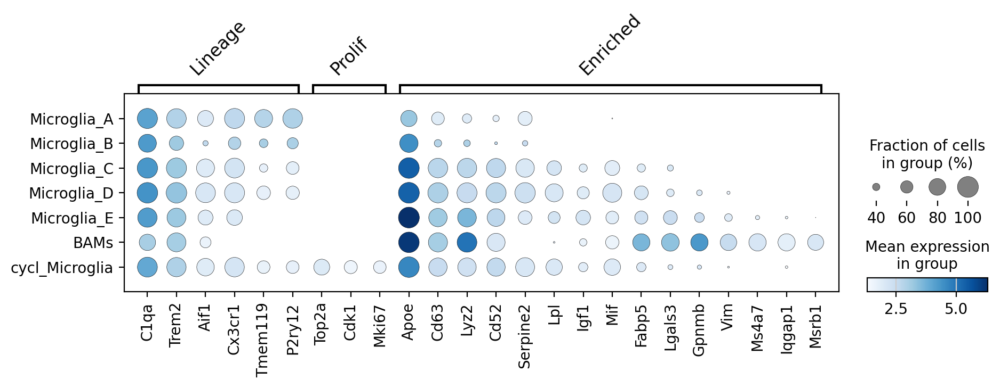

In [24]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Lineage': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'Tmem119', 'P2ry12'],
    'Prolif': ['Top2a', 'Cdk1', 'Mki67'],
    'Enriched': ['Apoe', 'Cd63', 'Lyz2', 'Cd52', 'Serpine2', 'Lpl', 'Igf1', 'Mif', 'Fabp5', 
             'Lgals3', 'Gpnmb', 'Vim', 'Ms4a7', 'Iqgap1', 'Msrb1'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group
    
# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_BAM",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='Blues',  # Choose a color map
    show=False,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1,
)

# Save the plot
plt.savefig('./figures/dot_plot_MG_types_UPDATED.png')

# Show the plot
plt.show()

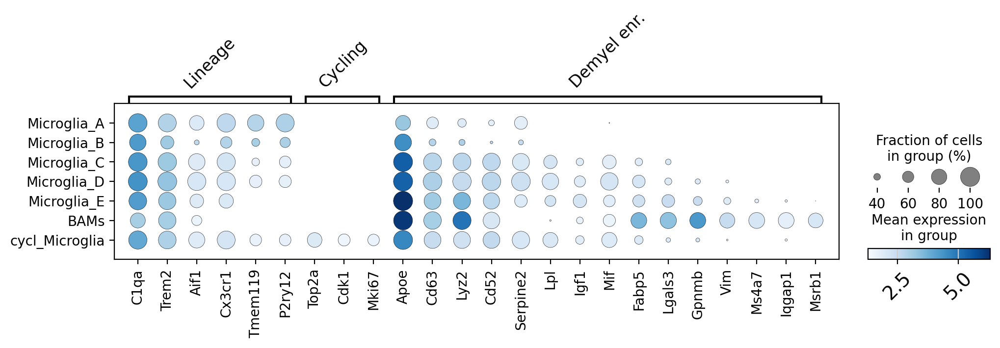

In [25]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Lineage': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'Tmem119', 'P2ry12'],
    'Cycling': ['Top2a', 'Cdk1', 'Mki67'],
    'Demyel enr.': ['Apoe', 'Cd63', 'Lyz2', 'Cd52', 'Serpine2', 'Lpl', 'Igf1', 'Mif', 'Fabp5', 
             'Lgals3', 'Gpnmb', 'Vim', 'Ms4a7', 'Iqgap1', 'Msrb1'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group

# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_BAM",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='Blues',  # Choose a color map
    show=False,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1,
)

# Get the current Axes instance
ax = plt.gca()

# Set the font size and rotation angle for the x-axis (gene labels)
plt.setp(ax.get_xticklabels(), fontsize=14, rotation=45)

# Set the font size for the y-axis (cell type labels)
ax.set_ylabel(ax.get_ylabel(), fontsize=16)

# Set the font size for the x-axis (gene labels)
ax.set_xlabel(ax.get_xlabel(), fontsize=16)

# Adjust spacing between y-axis ticks
plt.subplots_adjust(left=0.1)  # Adjust left margin to reduce space between y-axis ticks and the plot
#plt.subplots_adjust(bottom=0.5) 
plt.subplots_adjust(top=0.8) 

# Save the plot
plt.savefig('./figures/dot_plot_MG_types_UPDATED.png')

# Show the plot
plt.show()

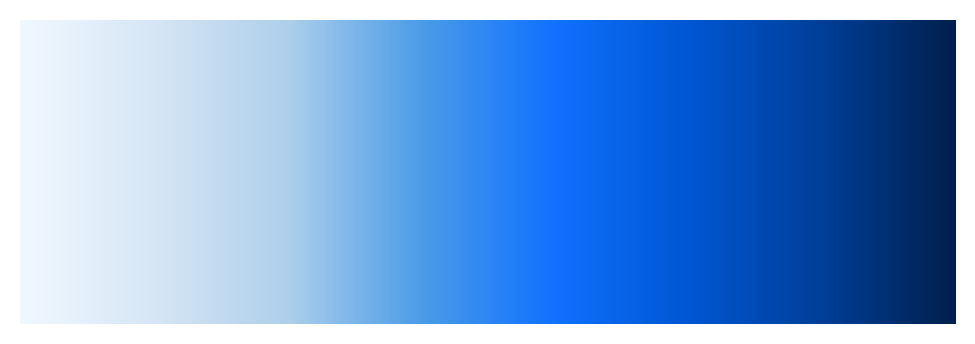

In [7]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt


# Define the custom blue colormap
blue_colors = ['#f0f8ff', '#d6e6f5', '#adcfeb', '#4b9ce7', '#1072ff', '#0057d4', '#003f99', '#00204d']
custom_blues = LinearSegmentedColormap.from_list('CustomBlues', blue_colors, N=512)

# Create a gradient for visualization
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))

# Plot the custom colormap
fig, ax = plt.subplots(figsize=(6, 2))

# Show the gradient with the custom colormap
ax.imshow(gradient, aspect='auto', cmap=custom_blues)

# Turn off the axes for a clean look
ax.set_axis_off()

# Show the plot
plt.show()

# RE-NAMING STARTS HERE

In [9]:
adata_sub = adata[adata.obs['leiden_MG_r0.5'] != '12'].copy()
print(adata_sub.obs['leiden_MG_r0.5'].unique())
print(adata_sub.shape)

['1', '9', '4', '5', '7', ..., '8', '10', '6', '3', '11']
Length: 12
Categories (12, object): ['0', '1', '2', '3', ..., '8', '9', '10', '11']
(52981, 19308)


In [12]:
adata_sub = sc.read_h5ad('./adata_MG_fine_type_WORKING.h5ad')
adata_sub

AnnData object with n_obs × n_vars = 52981 × 19308
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'S_score', 'G2M_score', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'cluster_annotation', 'cell_leiden_annotated', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2', 'leiden_MG_r0.5', 'leiden_MG_r0.7', 'leiden_MG_r1', 'leiden_MG_r0.3', 'minimal_treatment_map', 'MG_type_fine', 'MG_leiden_annotated', 'NEW_treatment_map', 'individual_lesion_condition', 'MG_type_broad', 'MG_type_fine_reduced', 'MG_type_fine_NEW', 'MG_type_fine_NEW_NUMBERED', 'MG_type_fine_NUMBERED'
    var: 'hb', 'ribo', 'n_

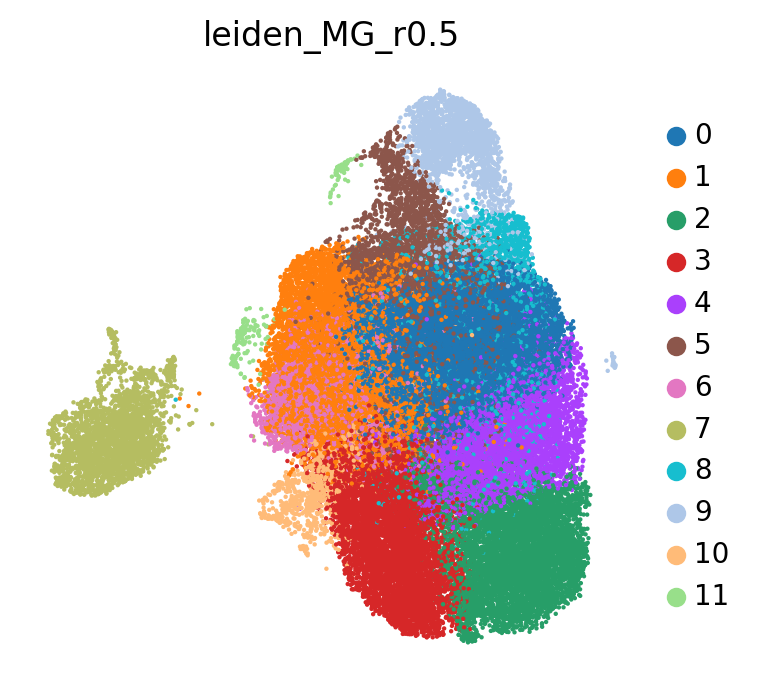

In [13]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_sub, color=['leiden_MG_r0.5'], legend_fontsize =float(10) , wspace=0.6,
           legend_fontweight= 'bold', frameon= False, s=10,
           legend_fontoutline=1)

In [14]:
today='_Sep26'

In [15]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
        '0': 'Microglia_C',
        '1': 'Microglia_D',
        '2': 'Microglia_B',
        '3': 'Microglia_A',
        '4': 'Microglia_C',
        '5': 'Microglia_C',
        '6': 'Microglia_D',
        '7': 'Microglia_E',
        '8': 'Microglia_C',
        '9': 'cycl_Microglia',
        '10': 'Microglia_A',
        '11': 'Microglia_E',
}

adata_sub.obs['MG_type_fine_NEW'] = adata_sub.obs['leiden_MG_r0.5'].map(cell_type).astype('category')

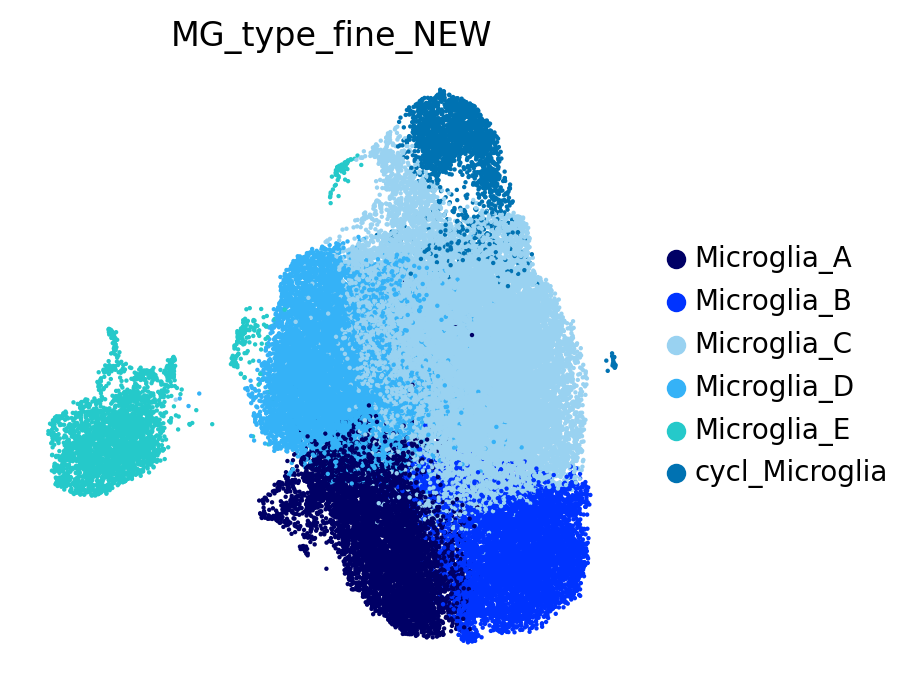

In [16]:
cluster_color = {
    'Microglia_E': '#25c9ca',      
    'cycl_Microglia': '#0072B2',  
    'Microglia_A': '#000066',    
    'Microglia_B': '#0033ff',    
    'Microglia_D': '#35b2f7',  
    'Microglia_C': '#99d2f1'
}

# Define the desired order of cell types in the legend
desired_order = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'Microglia_D', 'Microglia_E',
                 'cycl_Microglia']

# Reorder the categories in the 'cell_type_fine_mm' column of adata_ol_ol
adata_sub.obs['MG_type_fine_NEW'] = pd.Categorical(adata_sub.obs['MG_type_fine_NEW'], 
                                                    categories=desired_order, 
                                                    ordered=True)

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_sub, color=['MG_type_fine_NEW'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='',
           legend_fontweight= 'bold', frameon= False, s=10, 
           legend_fontoutline=1, save=today+'_annotated_cell_types_MG.png' )

In [38]:
# Unique values in the 'condition' column
unique_conditions = adata_sub.obs['individual_lesion_condition'].unique()
for condition in unique_conditions:
    print(condition)

LPC_7d
LPC_Saline
Cupr_5w
Cupr_ctrl_Adams
LPC_5d
LPC_28d
LPC_ctrl
LPC_14d
Cupr_4+3w
Cupr_4w
Cupr_ctrl_Shen


In [19]:
status_updated = {
    'LPC_7d': 'LPC_demyel',
    'LPC_Saline': 'LPC_baseline',
    'Cupr_5w': 'Cupr_demyel',
    'Cupr_ctrl_Adams': 'Cupr_baseline',
    'LPC_5d': 'LPC_demyel',
    'LPC_28d': 'LPC_remyel',
    'LPC_ctrl': 'LPC_baseline',
    'LPC_14d': 'LPC_mid_remyel',
    'Cupr_4+3w': 'Cupr_remyel',
    'Cupr_4w': 'Cupr_demyel',
    'Cupr_ctrl_Shen': 'Cupr_baseline',
}

adata.obs['lesion_status'] = adata.obs['individual_lesion_condition'].map(status_updated)

In [20]:
# Unique values in the 'condition' column
unique_conditions = adata.obs['lesion_status'].unique()
for condition in unique_conditions:
    print(condition)

LPC_demyel
LPC_baseline
Cupr_demyel
Cupr_baseline
LPC_remyel
LPC_mid_remyel
Cupr_remyel


scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


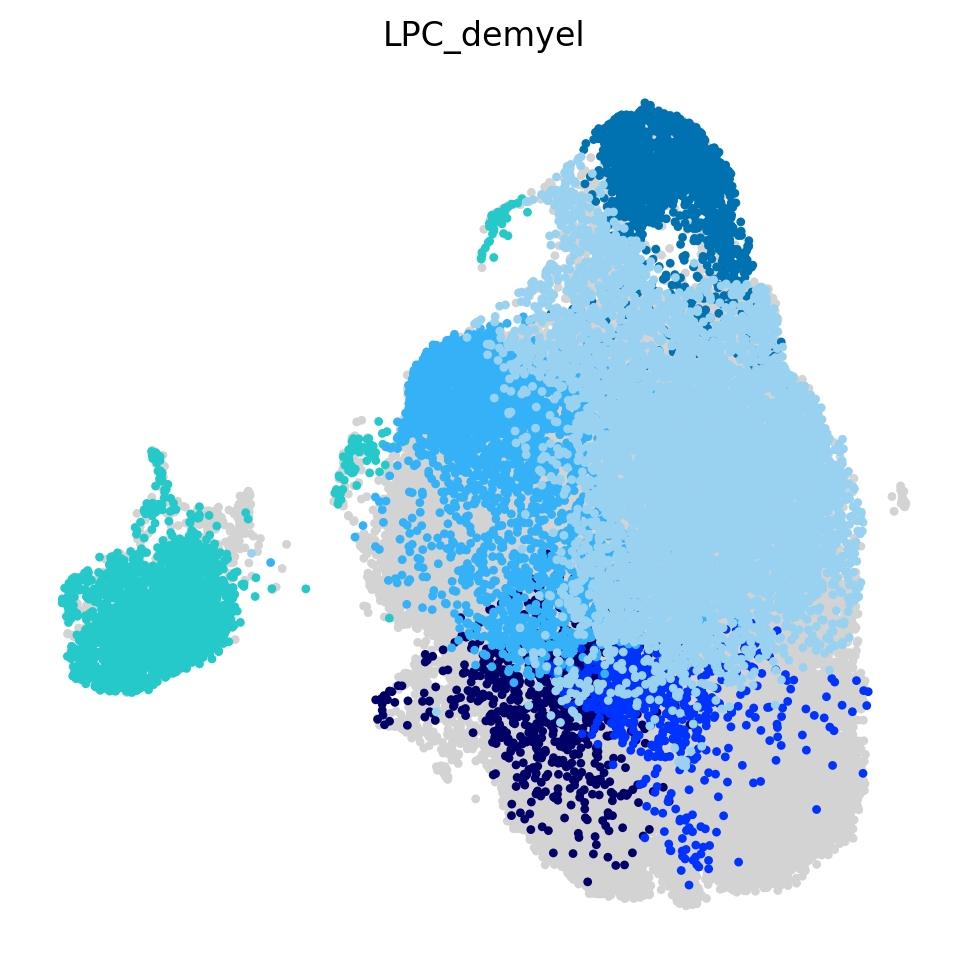

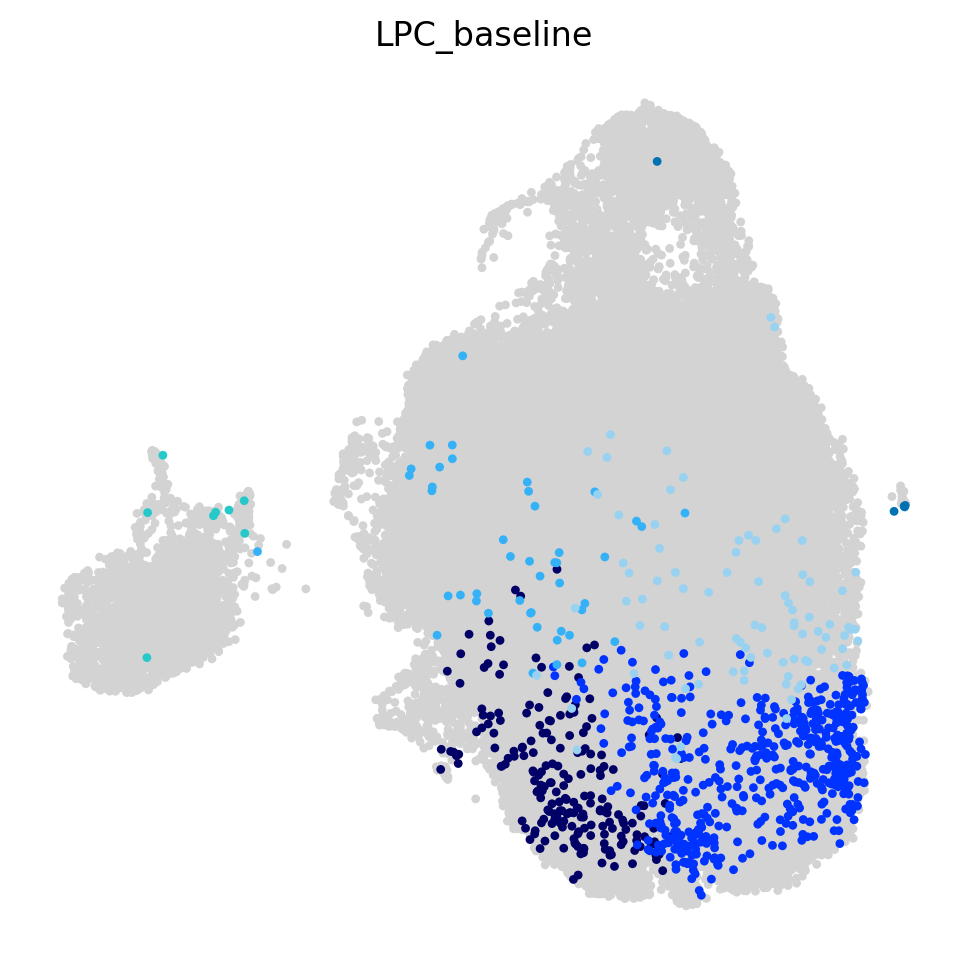

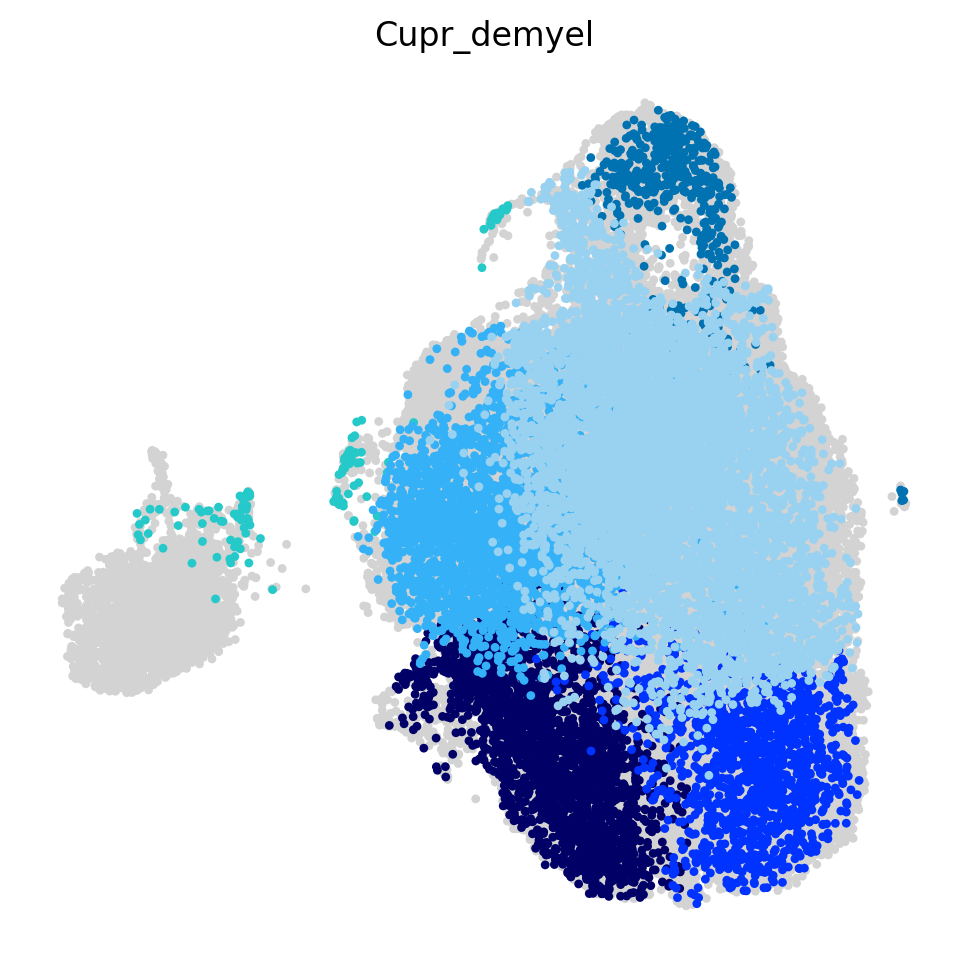

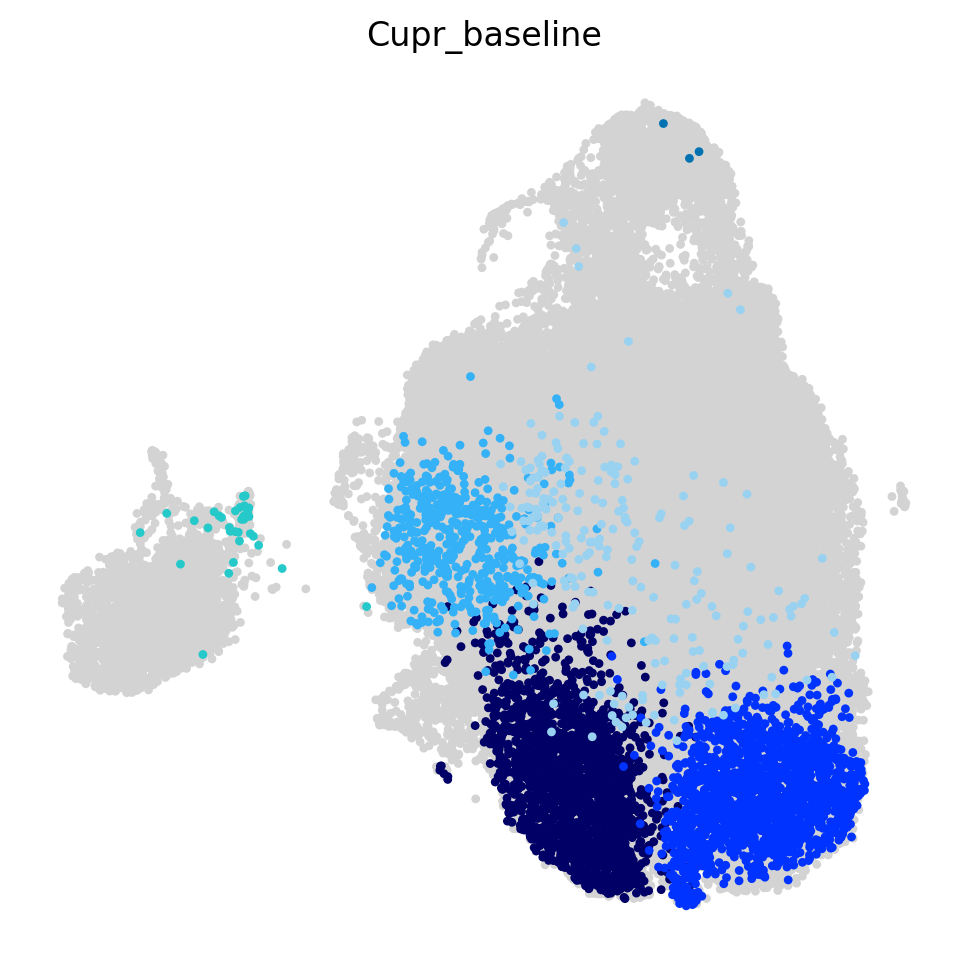

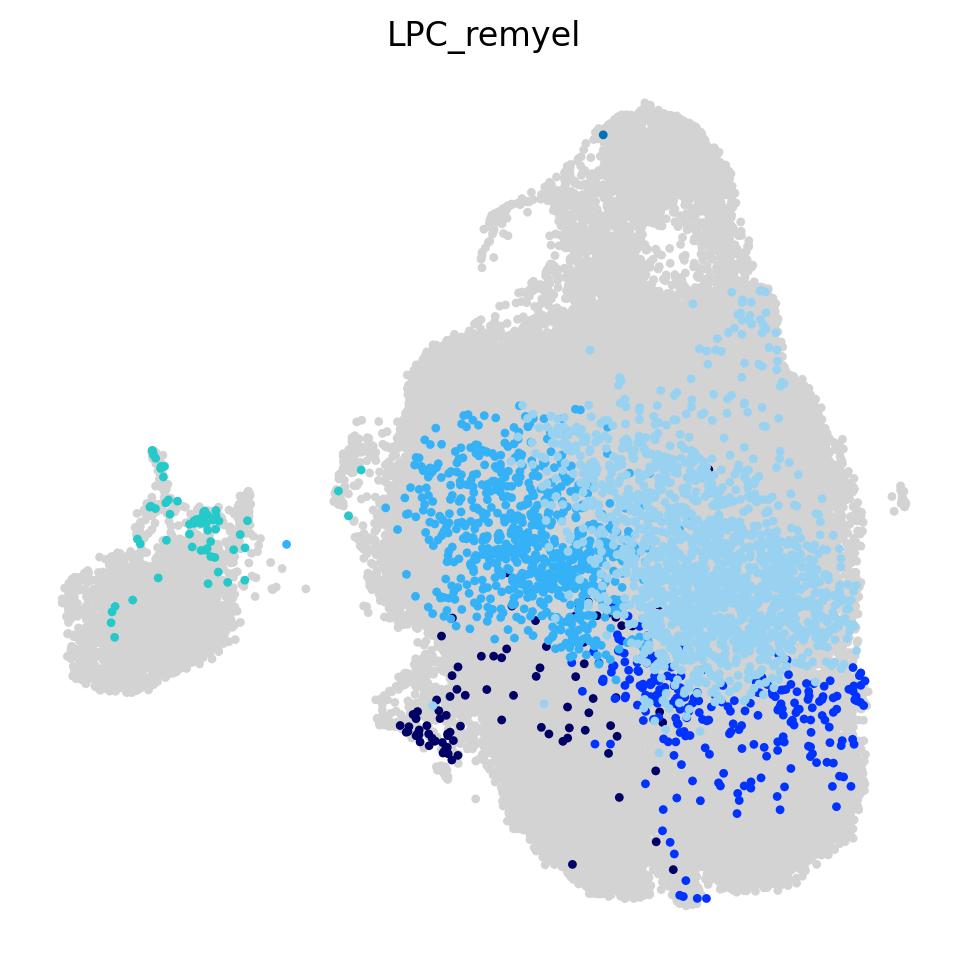

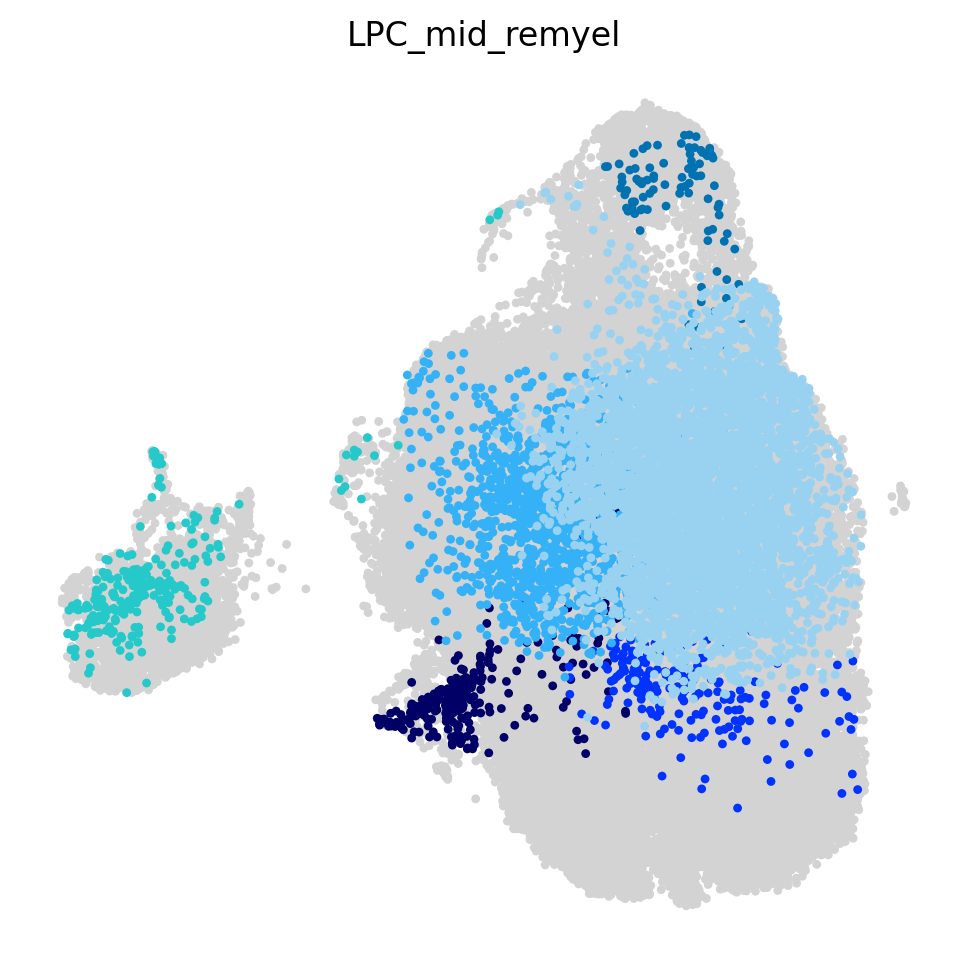

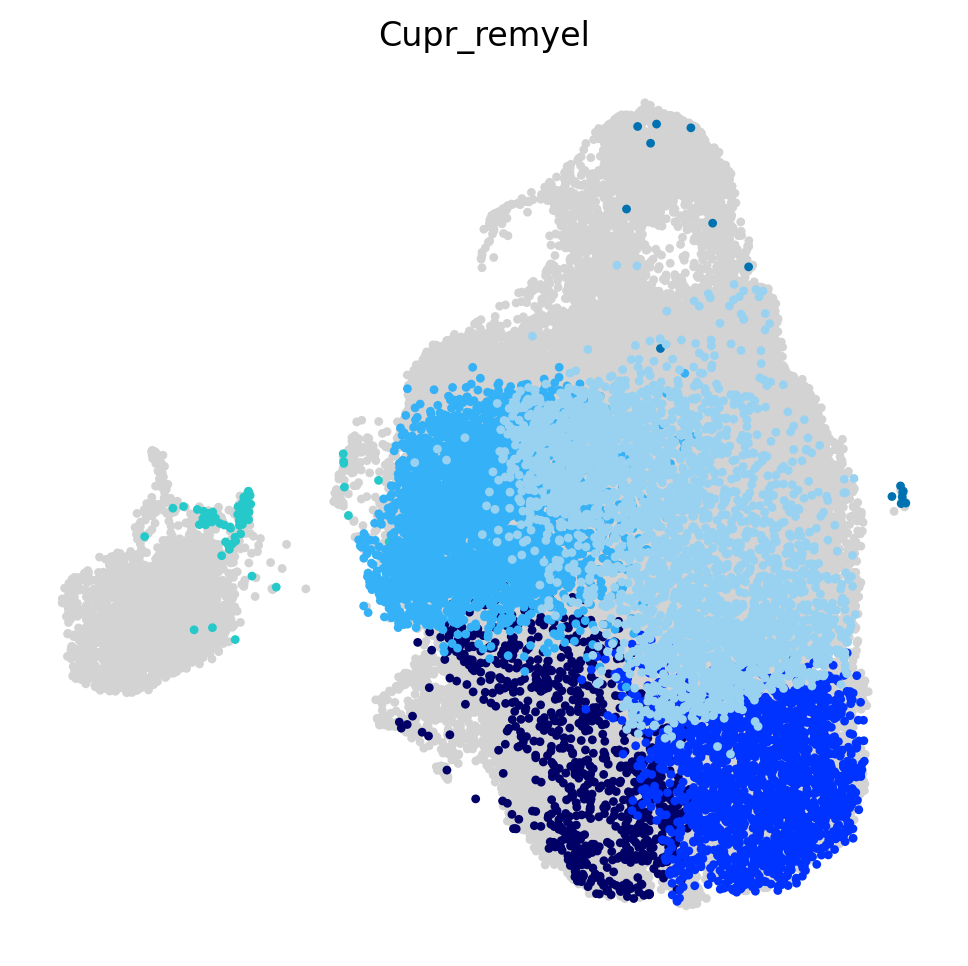

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc

plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=12) #color_map=mymap2)
sc.settings.figdir = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/MM_sysVI_cell_type_refined/sysVI_mm_MG_figures/'
sc.logging.print_header()

cluster_color = {
    'Microglia_E': '#25c9ca',      
    'cycl_Microglia': '#0072B2',  
    'Microglia_A': '#000066',    
    'Microglia_B': '#0033ff',    
    'Microglia_D': '#35b2f7',  
    'Microglia_C': '#99d2f1'
}

# Set a grey color for cells not in the current lesion_status
grey_color = '#d3d3d3'

# Iterate over unique lesion_statuses
for lesion_status in adata_sub.obs['lesion_status'].unique():
    # Create a mask for cells in the specific lesion_status
    lesion_mask = adata_sub.obs['lesion_status'] == lesion_status

    # Initialize color vector for cells not in the lesion_status
    colors = np.array([grey_color] * adata_sub.shape[0])  # Initialize all to grey

    # Plot UMAP with grey dots first
    plt.figure(figsize=(5, 5))  # Ensure figure size matches settings
    umap_coords = adata_sub.obsm['X_umap']
    grey_mask = ~lesion_mask
    plt.scatter(umap_coords[grey_mask, 0], umap_coords[grey_mask, 1], 
                color=grey_color, s=10, edgecolor='none')

    # Overlay cell type colors on top
    for cell_type in cluster_color:
        # Assign the specific cluster color for cells of the current type in the lesion_status
        cell_type_mask = (adata_sub.obs['MG_type_fine_NEW'] == cell_type) & lesion_mask
        plt.scatter(umap_coords[cell_type_mask, 0], umap_coords[cell_type_mask, 1], 
                    color=cluster_color[cell_type], s=10, edgecolor='none')

    # Customize plot appearance
    plt.title(f"{lesion_status}", fontsize=12)  # Ensure title is added with fontsize
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    
    # Remove grid and axes
    plt.grid(False)
    plt.gca().set_axis_off()

    # Save the plot with specified parameters
    plt.tight_layout()
    plt.savefig(f"{sc.settings.figdir}/{lesion_status}_combined_umap.png", dpi=300, transparent=True)

    # Show the plot in the console
    plt.show()

    # Close the plot
    plt.close()

In [18]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
        '0': '3_Microglia_C',
        '1': '4_Microglia_D',
        '2': '2_Microglia_B',
        '3': '1_Microglia_A',
        '4': '3_Microglia_C',
        '5': '3_Microglia_C',
        '6': '4_Microglia_D',
        '7': '5_Microglia_E',
        '8': '3_Microglia_C',
        '9': '6_cycl_Microglia',
        '10': '1_Microglia_A',
        '11': '5_Microglia_E',
}

adata_sub.obs['MG_type_fine_NEW_NUMBERED'] = adata_sub.obs['leiden_MG_r0.5'].map(cell_type).astype('category')

In [20]:
time='_Sep26'

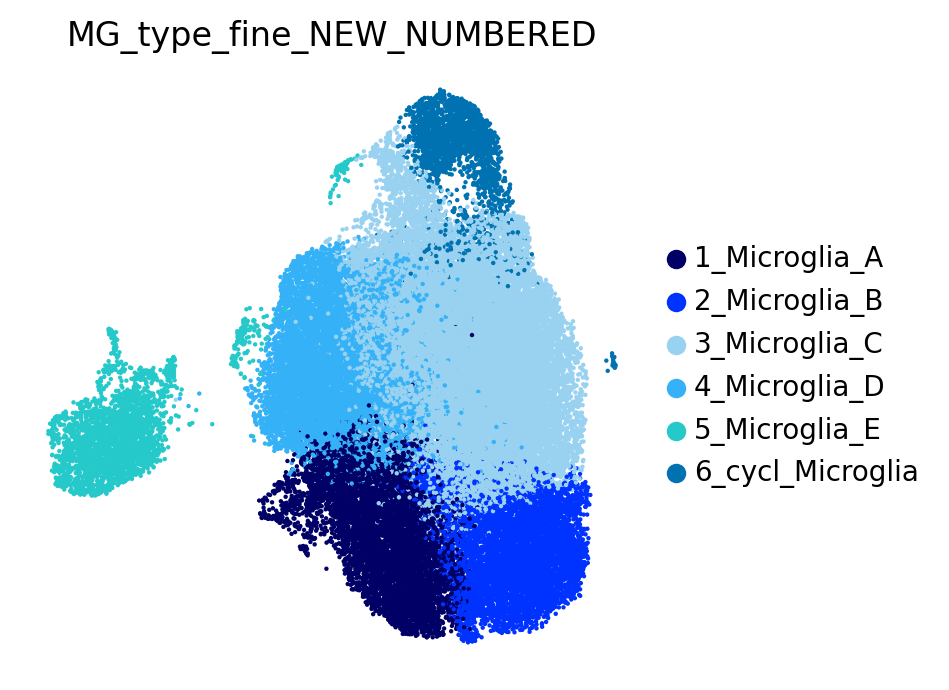

In [21]:
cluster_color = {
    '5_Microglia_E': '#25c9ca',      
    '6_cycl_Microglia': '#0072B2',  
    '1_Microglia_A': '#000066',    
    '2_Microglia_B': '#0033ff',    
    '4_Microglia_D': '#35b2f7',  
    '3_Microglia_C': '#99d2f1'
}

# Define the desired order of cell types in the legend
desired_order = ['1_Microglia_A', '2_Microglia_B', '3_Microglia_C', '4_Microglia_D', '5_Microglia_E', '6_cycl_Microglia']

# Reorder the categories in the 'cell_type_fine_mm' column of adata_ol_ol
adata_sub.obs['MG_type_fine_NEW_NUMBERED'] = pd.Categorical(adata_sub.obs['MG_type_fine_NEW_NUMBERED'], 
                                                    categories=desired_order, 
                                                    ordered=True)

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_sub, color=['MG_type_fine_NEW_NUMBERED'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color,
           legend_fontweight= 'bold', frameon= False, s=10, 
           legend_fontoutline=1, save=time+'_annotated_cell_types_NEW_NUMBERED.png' )

In [22]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
    'Microglia_E': '5',      
    'cycl_Microglia': '6',  
    'Microglia_A': '1',    
    'Microglia_B': '2',    
    'Microglia_D': '4',  
    'Microglia_C': '3'
}

adata_sub.obs['MG_type_fine_NUMBERED'] = adata_sub.obs['MG_type_fine_NEW'].map(cell_type).astype('category')

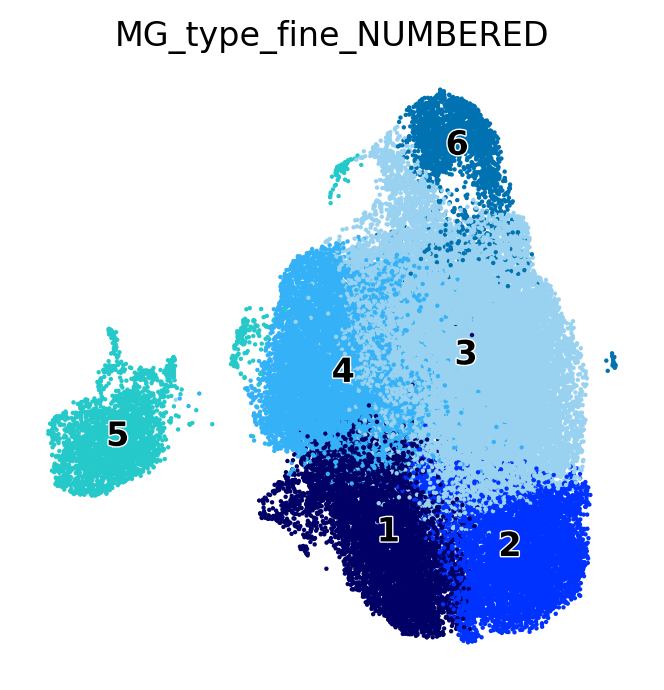

In [23]:
cluster_color = {
    '5': '#25c9ca',
    '6': '#0072B2',
    '1': '#000066',
    '2': '#0033ff',
    '4': '#35b2f7',
    '3': '#99d2f1'
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_sub, color=['MG_type_fine_NUMBERED'], legend_fontsize =float(12) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, legend_loc='on data',
           legend_fontweight= 'bold', frameon= False, s=10, 
           legend_fontoutline=1, save=time+'_annotated_cell_types_NUMBERED_only.png' )

In [12]:
adata

AnnData object with n_obs × n_vars = 52981 × 19308
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'S_score', 'G2M_score', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'cluster_annotation', 'cell_leiden_annotated', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2', 'leiden_MG_r0.5', 'leiden_MG_r0.7', 'leiden_MG_r1', 'leiden_MG_r0.3', 'minimal_treatment_map', 'MG_type_fine', 'MG_leiden_annotated', 'NEW_treatment_map', 'individual_lesion_condition', 'MG_type_broad', 'MG_type_fine_reduced', 'MG_type_fine_NEW', 'MG_type_fine_NEW_NUMBERED', 'MG_type_fine_NUMBERED', 'MG_type_fine_LETTER'
   

In [13]:
adata_sub = adata.copy()
adata_sub

AnnData object with n_obs × n_vars = 52981 × 19308
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'S_score', 'G2M_score', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'cluster_annotation', 'cell_leiden_annotated', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2', 'leiden_MG_r0.5', 'leiden_MG_r0.7', 'leiden_MG_r1', 'leiden_MG_r0.3', 'minimal_treatment_map', 'MG_type_fine', 'MG_leiden_annotated', 'NEW_treatment_map', 'individual_lesion_condition', 'MG_type_broad', 'MG_type_fine_reduced', 'MG_type_fine_NEW', 'MG_type_fine_NEW_NUMBERED', 'MG_type_fine_NUMBERED', 'MG_type_fine_LETTER'
   

In [14]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata.obs.groupby(['lesion_status', 'MG_type_fine_NEW']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='MG_type_fine_NEW', columns='lesion_status', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/1009942.1.gpu/ipykernel_3799569/2959023363.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata.obs.groupby(['lesion_status', 'MG_type_fine_NEW']).size().reset_index(name='cell_count')


MG_type_fine_NEW,Microglia_A,Microglia_B,Microglia_C,cycl_Microglia,Microglia_D,Microglia_E,Microglia_F
lesion_status,,,,,,,
Cupr_baseline,40.385925,42.587968,4.767310,0.068104,0.181612,11.237230,0.771850
Cupr_demyel,9.639678,17.829457,35.450761,3.517083,12.970141,19.666954,0.925926
Cupr_remyel,21.276831,9.869440,33.049347,0.165966,0.663864,34.222173,0.752379
LPC_baseline,58.885017,24.390244,9.523810,0.580720,0.464576,5.226481,0.929152
LPC_demyel,4.487096,6.088704,36.279341,9.888471,10.271041,18.116976,14.868370
LPC_mid_remyel,2.981686,4.268200,64.855456,1.392463,4.752535,18.041471,3.708188
LPC_remyel,8.541973,3.276878,58.910162,0.036819,0.662739,26.178203,2.393225


In [ ]:
LPC_baseline = sc.pp.subsample(adata_sub[adata_sub.obs['lesion_status']=='LPC_baseline'],n_obs=800,copy=True).obs_names
LPC_demyel = sc.pp.subsample(adata_sub[adata_sub.obs['lesion_status']=='LPC_demyel'],n_obs=800,copy=True).obs_names
LPC_remyel = sc.pp.subsample(adata_sub[adata_sub.obs['lesion_status']=='LPC_remyel'],n_obs=800,copy=True).obs_names

Cupr_baseline = sc.pp.subsample(adata_sub[adata_sub.obs['lesion_status']=='Cupr_baseline'],n_obs=800,copy=True).obs_names
Cupr_demyel = sc.pp.subsample(adata_sub[adata_sub.obs['lesion_status']=='Cupr_demyel'],n_obs=800,copy=True).obs_names
Cupr_remyel = sc.pp.subsample(adata_sub[adata_sub.obs['lesion_status']=='Cupr_remyel'],n_obs=800,copy=True).obs_names

adata_all_subsample = adata_sub[list(LPC_baseline) + list(LPC_demyel)+list(LPC_remyel)
                                +list(Cupr_baseline)+list(Cupr_demyel)+list(Cupr_remyel)].copy()

In [ ]:
sc.tl.embedding_density(adata_all_subsample, basis='umap', groupby='lesion_status')

In [ ]:
sc.pl.embedding_density(adata_all_subsample, basis='umap',  key='umap_density_lesion_status', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, 
                        ncols=3)# save=time+'_MG_distribution_downscaling_all.png')

In [ ]:
sc.pl.embedding_density(adata_all_subsample, basis='umap',  key='umap_density_lesion_status', color_map='Blues', wspace=0.3, bg_dotsize = 8, frameon= False, 
                        ncols=3, save=time+'_MG_distribution_downscaling_all_blues.png')

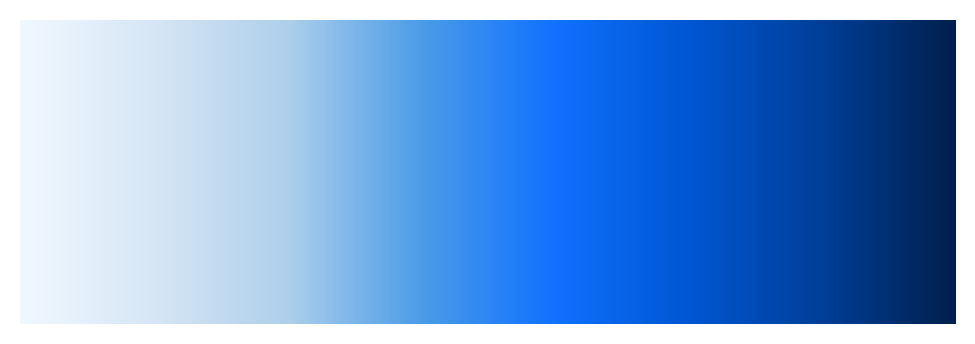

In [6]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt


# Define the custom blue colormap
blue_colors = ['#f0f8ff', '#d6e6f5', '#adcfeb', '#4b9ce7', '#1072ff', '#0057d4', '#003f99', '#00204d']
custom_blues = LinearSegmentedColormap.from_list('CustomBlues', blue_colors, N=512)

# Create a gradient for visualization
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))

# Plot the custom colormap
fig, ax = plt.subplots(figsize=(6, 2))

# Show the gradient with the custom colormap
ax.imshow(gradient, aspect='auto', cmap=custom_blues)

# Turn off the axes for a clean look
ax.set_axis_off()

# Show the plot
plt.show()

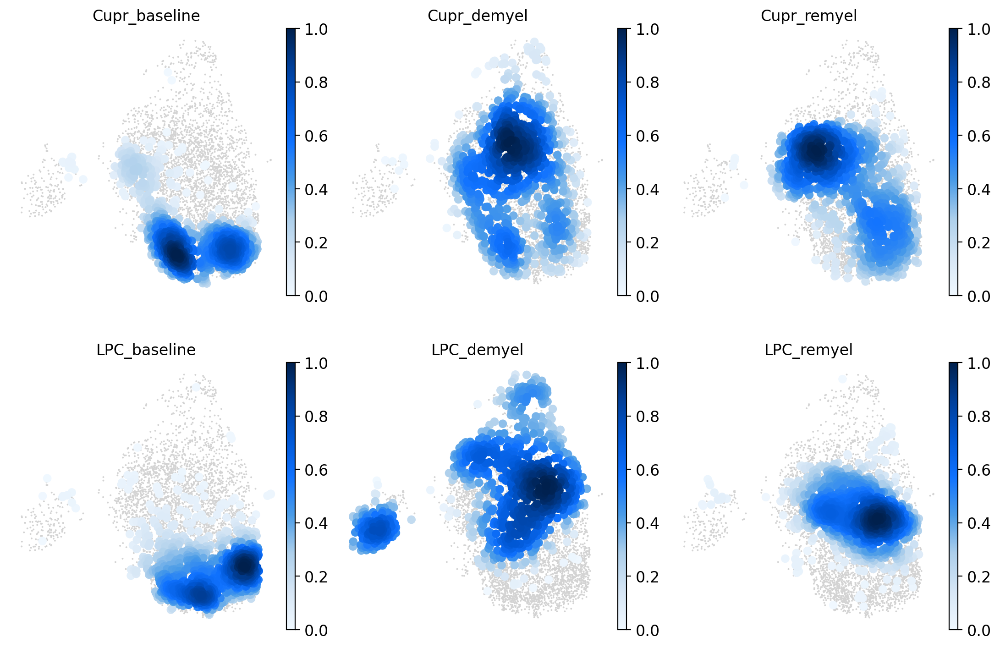

In [47]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

# Define the custom blue colormap
blue_colors = ['#f0f8ff', '#d6e6f5', '#adcfeb', '#4b9ce7', '#1072ff', '#0057d4', '#003f99', '#00204d']
custom_blues = LinearSegmentedColormap.from_list('CustomBlues', blue_colors, N=512)

# Use the custom colormap in the plot
sc.pl.embedding_density(adata_all_subsample, basis='umap', key='umap_density_lesion_status', 
                        color_map=custom_blues, wspace=0.1, bg_dotsize=8, frameon=False, 
                        ncols=3, save='_distribution_downscaling_all_NEW_BLUES.png')

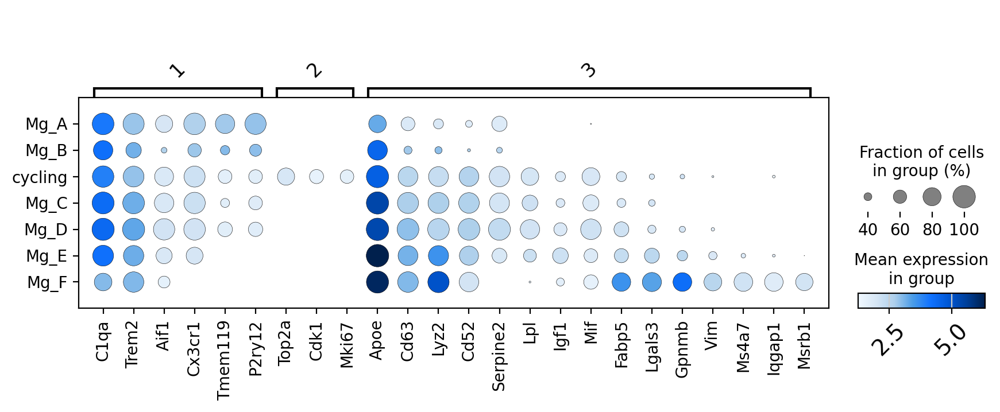

In [32]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    '1': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'Tmem119', 'P2ry12'],
    '2': ['Top2a', 'Cdk1', 'Mki67'],
    '3': ['Apoe', 'Cd63', 'Lyz2', 'Cd52', 'Serpine2', 'Lpl', 'Igf1', 'Mif', 'Fabp5', 
             'Lgals3', 'Gpnmb', 'Vim', 'Ms4a7', 'Iqgap1', 'Msrb1'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group

# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW_REDUCED",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    color_map=custom_blues,  # Choose a color map
    show=False,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1,
)

# Get the current Axes instance
ax = plt.gca()

# Set the font size and rotation angle for the x-axis (gene labels)
plt.setp(ax.get_xticklabels(), fontsize=14, rotation=45)

# Set the font size for the y-axis (cell type labels)
ax.set_ylabel(ax.get_ylabel(), fontsize=16)

# Set the font size for the x-axis (gene labels)
ax.set_xlabel(ax.get_xlabel(), fontsize=16)

# Adjust spacing between y-axis ticks
plt.subplots_adjust(left=0.2)  # Adjust left margin to reduce space between y-axis ticks and the plot
#plt.subplots_adjust(bottom=0.5) 
plt.subplots_adjust(top=0.9) 

# Save the plot
plt.savefig('./figures/dot_plot_MG_types_UPDATED2.png')

# Show the plot
plt.show()

In [36]:
plt.rcParams['figure.figsize']=(7,7) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=300, dpi_save=300,transparent=True, fontsize=12) #color_map=mymap2)
sc.settings.figdir = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/MM_sysVI/figures/'
sc.logging.print_header()

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


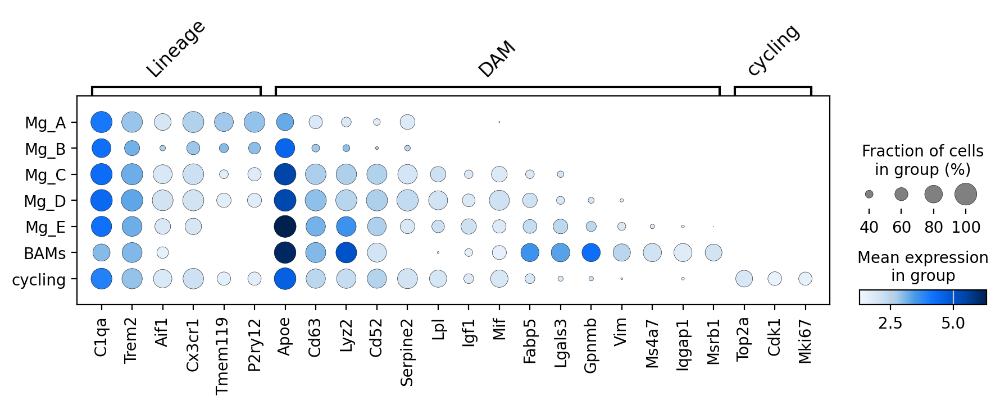

In [33]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Lineage': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'Tmem119', 'P2ry12'],
    'DAM': ['Apoe', 'Cd63', 'Lyz2', 'Cd52', 'Serpine2', 'Lpl', 'Igf1', 'Mif', 'Fabp5', 
             'Lgals3', 'Gpnmb', 'Vim', 'Ms4a7', 'Iqgap1', 'Msrb1'],
    'cycling': ['Top2a', 'Cdk1', 'Mki67'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group
    
# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW_REDUCED",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    color_map=custom_blues,  # Choose a color map
    show=False,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1,
)

# Save the plot
plt.savefig('./figures/dot_plot_MG_types_UPDATED3.png')

# Show the plot
plt.show()

/tmp/1030622.1.gpu/ipykernel_2298322/4001157141.py:23: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()  # Automatically adjust padding


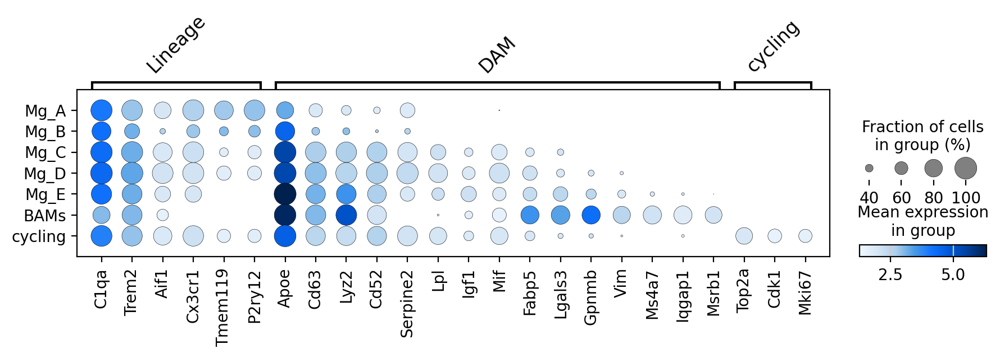

In [34]:
# Create the dotplot
ax = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW_REDUCED",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    color_map=custom_blues,  # Choose a color map
    show=False,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1,
)

# Adjust layout to ensure everything is displayed
plt.tight_layout()  # Automatically adjust padding
plt.subplots_adjust(bottom=0.3)  # Ensure more space for gene names

# Save the plot with adjusted layout
plt.savefig('./figures/dot_plot_MG_types_UPDATED3.png', bbox_inches='tight')

## **** USE THIS ONE!!!

# Show the plot
plt.show()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_MG_type_fine_NEW_REDUCED']`


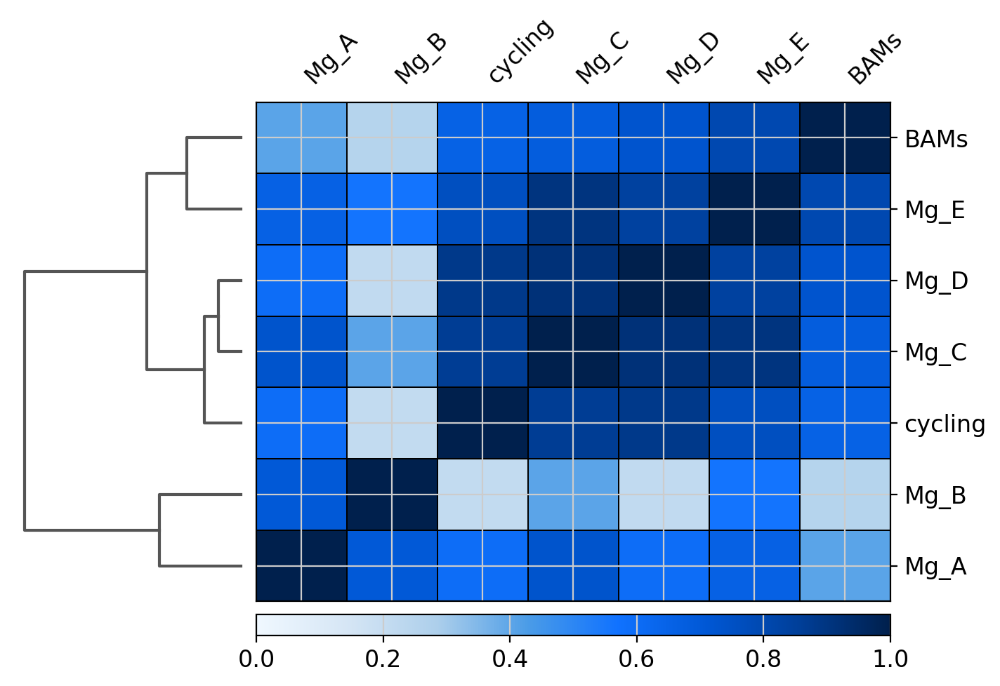

In [28]:
sc.pl.correlation_matrix(adata, "MG_type_fine_NEW_REDUCED", figsize=(8, 5),color='black', vmin=0, 
                              cmap=custom_blues, save='correlation_matrix_blues.png')

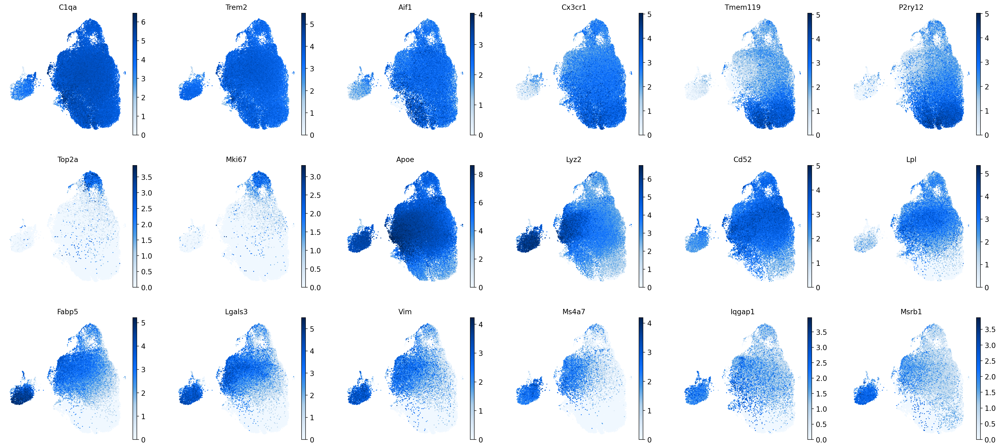

In [61]:
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'Tmem119', 'P2ry12', 'Top2a', 'Mki67',
          'Apoe', 'Lyz2', 'Cd52', 'Lpl', 'Fabp5', 'Lgals3', 'Vim', 'Ms4a7', 'Iqgap1', 'Msrb1'],
    frameon=False,
    ncols=6,
    s=10,
    use_raw=False,
    color_map=custom_blues,
    layer='log1p_norm',
    save=time+'_mm_sysVI_MG_genes3.pdf'
)

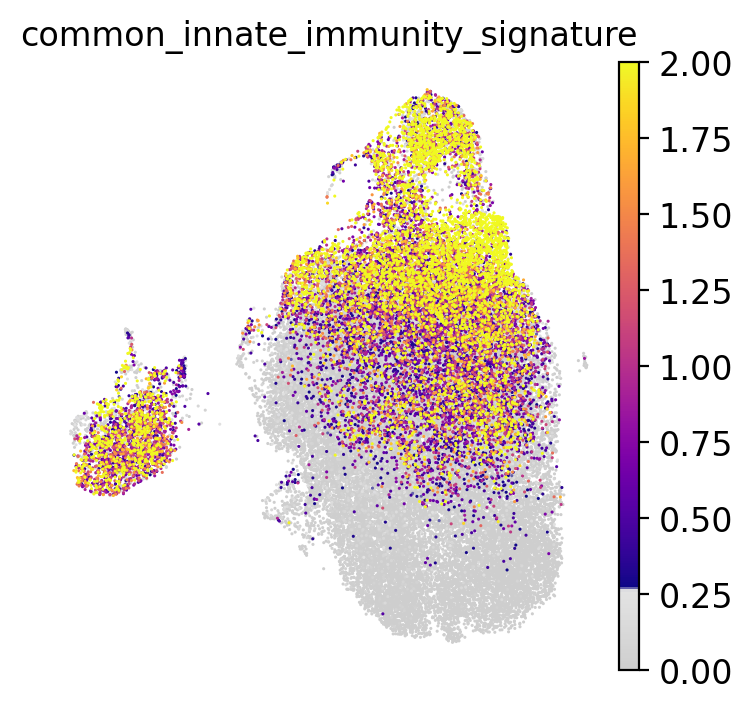

In [84]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['common_innate_immunity_signature'],legend_fontsize =float(12), 
           cmap=mymap2, vmin=0, vmax=2, 
           legend_fontweight= 'normal', s=5, 
           frameon= False, save=time+'innate_immune_signature.png' )

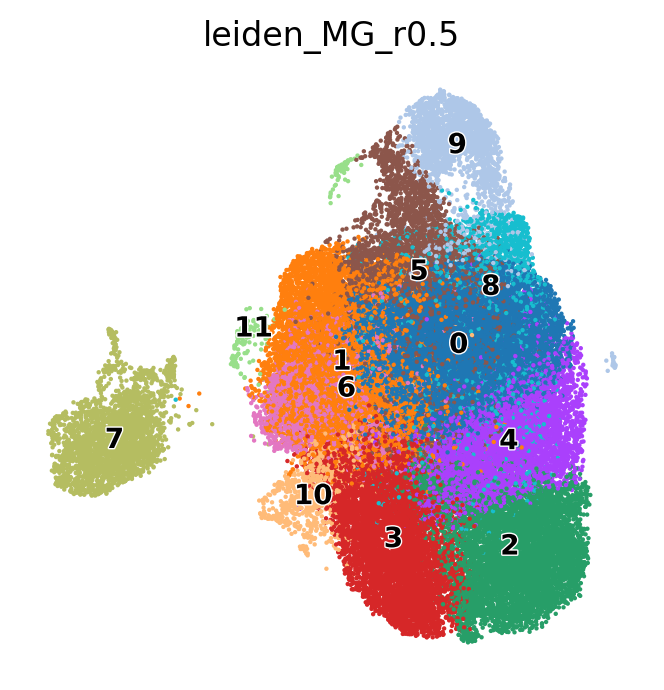

In [85]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['leiden_MG_r0.5'], legend_fontsize =float(10) , wspace=0.6,
           legend_fontweight= 'bold', frameon= False, s=10, legend_loc='on data',
           legend_fontoutline=1)

In [10]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
        '0': '0_Microglia_C',
        '1': '1_Microglia_E',
        '2': '2_Microglia_A',
        '3': '3_Microglia_B',
        '4': '4_Microglia_C',
        '5': '5_Microglia_D',
        '6': '6_Microglia_E',
        '7': '7_BAMs',
        '8': '8_Microglia_C',
        '9': '9_cycling',
        '10': '10_Microglia_B',
        '11': '11_BAMs',
}

adata.obs['leiden_annotation_r5'] = adata.obs['leiden_MG_r0.5'].map(cell_type).astype('category')

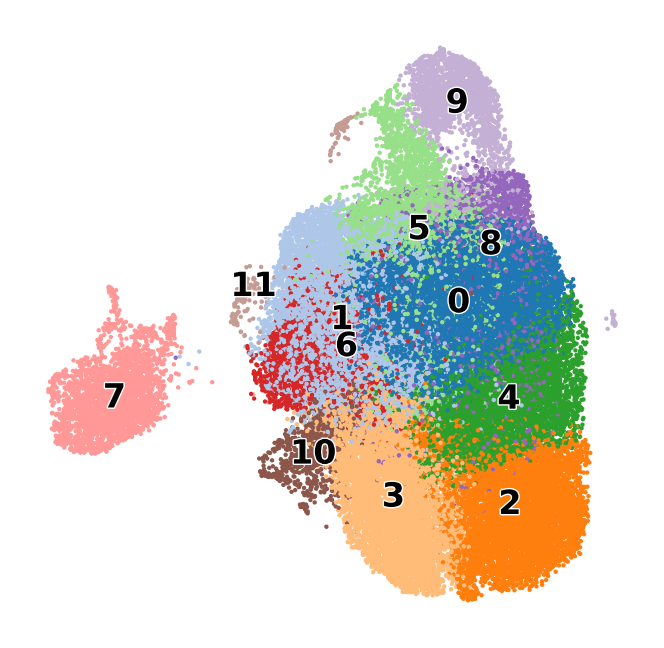

In [7]:
cluster_color = {
    '0': "#1f77b4",   # Blue
    '1': "#aec7e8",   # Light Blue
    '2': "#ff7f0e",   # Orange
    '3': "#ffbb78",   # Light Orange
    '4': "#2ca02c",   # Green
    '5': "#98df8a",   # Light Green
    '6': "#d62728",   # Red
    '7': "#ff9896",   # Light Red
    '8': "#9467bd",   # Purple
    '9': "#c5b0d5",   # Light Purple
    '10': "#8c564b",  # Brown
    '11': "#c49c94",  # Light Brown
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['leiden_MG_r0.5'], legend_fontsize =float(12) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='', legend_loc='on data',
           legend_fontweight= 'bold', frameon= False, s=10, 
           legend_fontoutline=1, save='_MG_leiden_numbered_NEW.png')

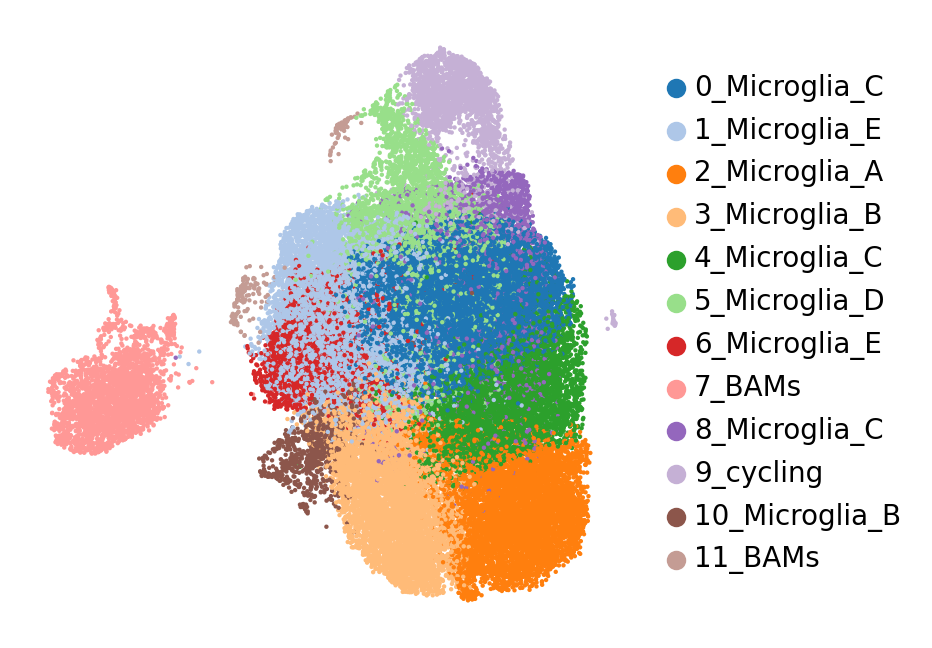

In [13]:
cluster_color = {
    '0_Microglia_C': '#1f77b4',  # Warm coral red
    '1_Microglia_E': '#aec7e8',  # Medium slate blue
    '2_Microglia_A': '#ff7f0e',  # Sea green 
    '3_Microglia_B': '#ffbb78',  # Warm amber
    '4_Microglia_C': '#2ca02c',  # Strong red
    '5_Microglia_D': '#98df8a',  # Bright blue
    '6_Microglia_E': '#d62728',  # Purple
    '7_BAMs': '#ff9896',  # Teal
    '8_Microglia_C': '#9467bd',  # Gold 
    '9_cycling': '#c5b0d5',  # Steel blue
    '10_Microglia_B': '#8c564b',  # Amethyst
    '11_BAMs': '#c49c94',  # Greenish
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['leiden_annotation_r5'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='',
           legend_fontweight= 'bold', frameon= False, s=10, 
           legend_fontoutline=1, save='_MG_leiden_labeled_NEW.png')

In [ ]:
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=['Top2a', 'Cdk1', 'Mki67'],
    frameon=False,
    ncols=4,
    s=5,
    use_raw=False,
    color_map=custom_blues,
    layer='log1p_norm',
    #save=time+'_mm_sysVI_MG_genes3.pdf'
)

In [123]:
del adata.uns['rank_genes_groups_filtered']

In [74]:
adata_sub.write_h5ad('./adata_MG_fine_type_WORKING.h5ad')
adata_sub

AnnData object with n_obs × n_vars = 52981 × 19308
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'S_score', 'G2M_score', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'cluster_annotation', 'cell_leiden_annotated', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2', 'leiden_MG_r0.5', 'leiden_MG_r0.7', 'leiden_MG_r1', 'leiden_MG_r0.3', 'minimal_treatment_map', 'MG_type_fine', 'MG_leiden_annotated', 'NEW_treatment_map', 'individual_lesion_condition', 'MG_type_broad', 'MG_type_fine_reduced', 'MG_type_fine_NEW', 'MG_type_fine_NEW_NUMBERED', 'MG_type_fine_NUMBERED'
    var: 'hb', 'ribo', 'n_

# TRY AGAIN!

In [89]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
        '0': 'Microglia_C',
        '1': 'Microglia_E',
        '2': 'Microglia_A',
        '3': 'Microglia_B',
        '4': 'Microglia_C',
        '5': 'Microglia_D',
        '6': 'Microglia_E',
        '7': 'Microglia_F',
        '8': 'Microglia_C',
        '9': 'cycl_Microglia',
        '10': 'Microglia_B',
        '11': 'Microglia_F',
}

adata_sub.obs['MG_type_fine_NEW'] = adata_sub.obs['leiden_MG_r0.5'].map(cell_type).astype('category')

In [91]:
# Define the desired order of cell types in the legend
desired_order = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'cycl_Microglia', 'Microglia_D', 'Microglia_E',
                 'Microglia_F']

# Reorder the categories in the 'cell_type_fine_mm' column of adata_ol_ol
adata_sub.obs['MG_type_fine_NEW'] = pd.Categorical(adata_sub.obs['MG_type_fine_NEW'], 
                                                    categories=desired_order, 
                                                    ordered=True)

In [14]:
cluster_color = {     
    'cycl_Microglia': '#0f5e9b',  
    'Microglia_A': '#000058',    
    'Microglia_B': '#0000cb',
    'Microglia_C': '#b3edf9',
    'Microglia_D': '#4bc4ff',  
    'Microglia_E': '#145eff', 
    'Microglia_F': '#85b9ff', 
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_sub, color=['MG_type_fine_NEW'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, title='',
           legend_fontweight= 'bold', frameon= False, s=20, 
           legend_fontoutline=1, save=today+'_annotated_cell_types_MG.png' )

NameError: name 'adata_sub' is not defined

In [150]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata_sub.obs.groupby(['lesion_status', 'MG_type_fine_NEW']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='MG_type_fine_NEW', columns='lesion_status', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/839511.1.gpu/ipykernel_2275316/2444222149.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata_sub.obs.groupby(['lesion_status', 'MG_type_fine_NEW']).size().reset_index(name='cell_count')


MG_type_fine_NEW,Microglia_A,Microglia_B,Microglia_C,cycl_Microglia,Microglia_D,Microglia_E,Microglia_F
lesion_status,,,,,,,
Cupr_baseline,40.385925,42.587968,4.767310,0.068104,0.181612,11.237230,0.771850
Cupr_demyel,9.639678,17.829457,35.450761,3.517083,12.970141,19.666954,0.925926
Cupr_remyel,21.276831,9.869440,33.049347,0.165966,0.663864,34.222173,0.752379
LPC_baseline,58.885017,24.390244,9.523810,0.580720,0.464576,5.226481,0.929152
LPC_demyel,4.487096,6.088704,36.279341,9.888471,10.271041,18.116976,14.868370
LPC_mid_remyel,2.981686,4.268200,64.855456,1.392463,4.752535,18.041471,3.708188
LPC_remyel,8.541973,3.276878,58.910162,0.036819,0.662739,26.178203,2.393225


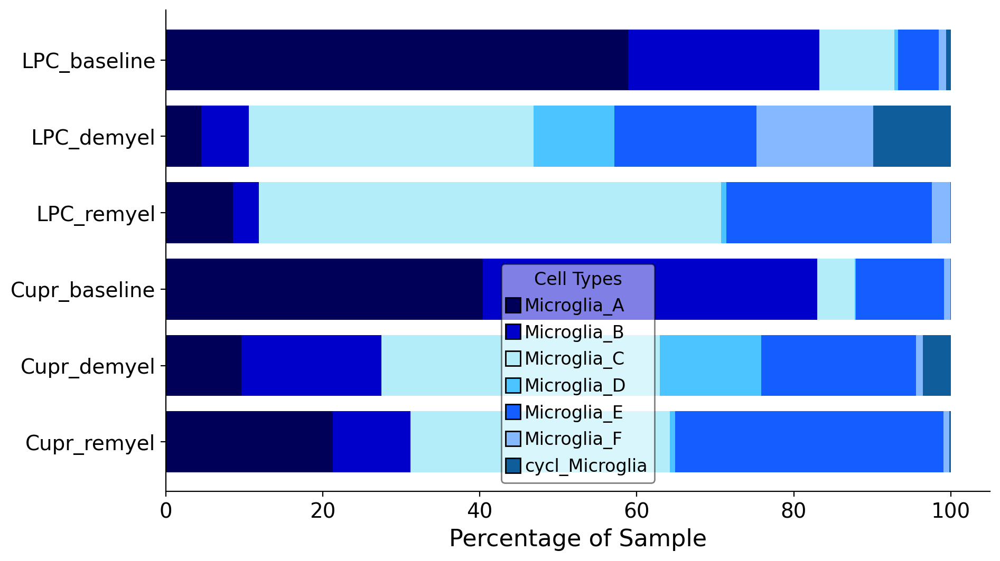

In [153]:
# Define the desired order of treatments and cell types
desired_treatments_order = ['LPC_baseline', 'LPC_demyel', 'LPC_mid_remyel', 'LPC_remyel',
                            'Cupr_baseline', 'Cupr_demyel', 'Cupr_remyel']
    
desired_cell_types_order = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'Microglia_D', 
                            'Microglia_E', 'Microglia_F', 'cycl_Microglia']

# Reorder the columns and the index of the percent_counts DataFrame
percent_counts_reordered = percent_counts_transposed[desired_cell_types_order].reindex(desired_treatments_order)

# Reorder the columns of the DataFrame with the 'other' category included
desired_cell_types_order_updated = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'Microglia_D', 
                            'Microglia_E', 'Microglia_F', 'cycl_Microglia']

# Remove the specific row from the DataFrame
percent_counts_reordered.drop(index='LPC_mid_remyel', inplace=True)

#Rename index
percent_counts_reordered.rename(index={'LPC_mid_remyel': 'LPC_mid_remyel'}, inplace=True)

percent_counts_reordered = percent_counts_reordered[desired_cell_types_order_updated]

# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'cycl_Microglia': '#0f5e9b',  
    'Microglia_A': '#000058',    
    'Microglia_B': '#0000cb',
    'Microglia_C': '#b3edf9',
    'Microglia_D': '#4bc4ff',  
    'Microglia_E': '#145eff', 
    'Microglia_F': '#85b9ff', 
}

# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_reordered.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Create legend with transparency
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_reordered.columns]
legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower center', fontsize=12, title='Cell Types')

# Set transparency of the legend
legend.get_frame().set_alpha(0.5)  # Set alpha value for transparency (0.5 makes it semi-transparent)

# Optionally, add a border color for contrast
legend.get_frame().set_edgecolor('black')  # Set border color of the legend

# Save the plot as a PNG file
plt.savefig('./sysVI_mm_MG_figures/MM_MG_cell_types_barh.png', bbox_inches='tight', dpi=300)  # Increase DPI for higher resolution

# Show the plot
plt.show()

In [154]:
#cell_type = {str(i): '' for i in range(18)}
cell_type = {
        '0': 'C',
        '1': 'E',
        '2': 'A',
        '3': 'B',
        '4': 'C',
        '5': 'D',
        '6': 'E',
        '7': 'F',
        '8': 'C',
        '9': 'cycl',
        '10': 'B',
        '11': 'F',
}

adata_sub.obs['MG_type_fine_LETTER'] = adata_sub.obs['leiden_MG_r0.5'].map(cell_type).astype('category')

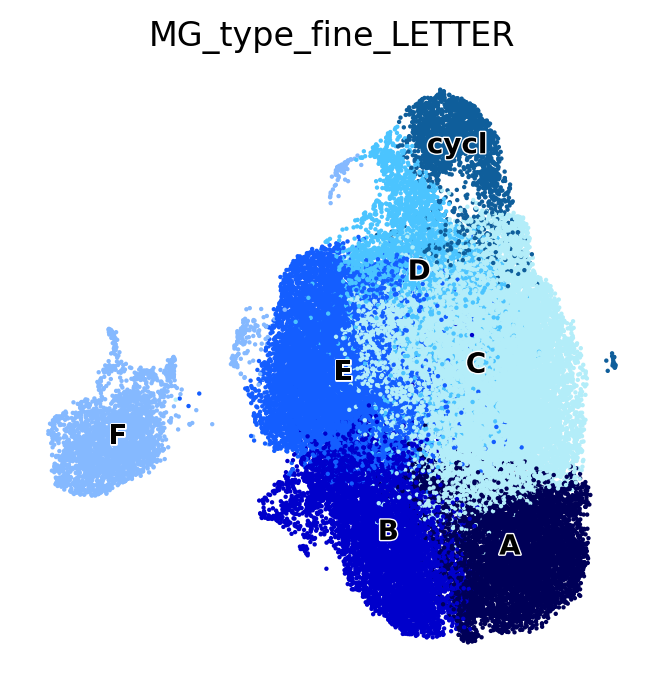

In [156]:
cluster_color = {     
    'cycl': '#0f5e9b',  
    'A': '#000058',    
    'B': '#0000cb',
    'C': '#b3edf9',
    'D': '#4bc4ff',  
    'E': '#145eff', 
    'F': '#85b9ff', 
}
# Define the desired order of cell types in the legend
desired_order = ['A', 'B', 'C', 'cycl', 'D', 'E', 'F']

# Reorder the categories in the 'cell_type_fine_mm' column of adata_ol_ol
adata_sub.obs['MG_type_fine_LETTER'] = pd.Categorical(adata_sub.obs['MG_type_fine_LETTER'], 
                                                    categories=desired_order, 
                                                    ordered=True)

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_sub, color=['MG_type_fine_LETTER'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, legend_loc = 'on data',
           legend_fontweight= 'bold', frameon= False, s=10, 
           legend_fontoutline=1, save=time+'_annotated_cell_types_NEW_NUMBERED.png' )

In [157]:
sc.tl.paga(adata_sub, groups='MG_type_fine_LETTER', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


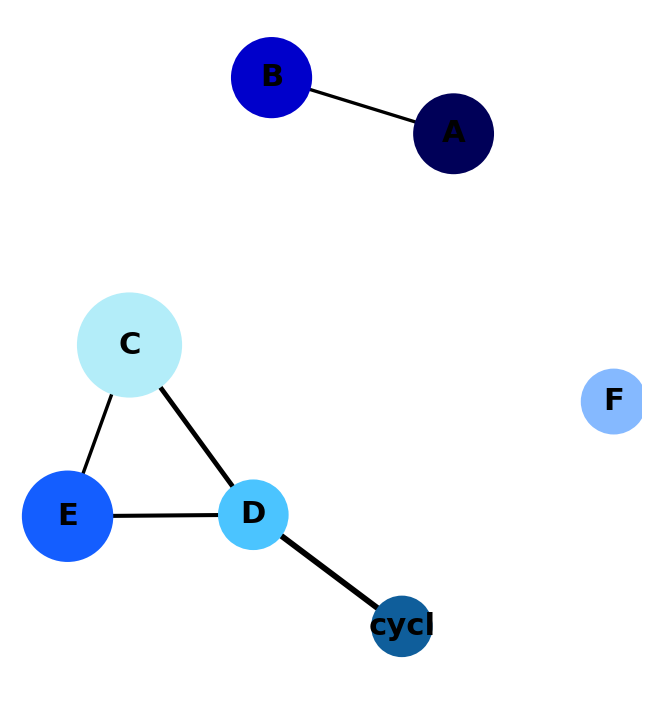

In [158]:
sc.pl.paga(adata_sub,threshold=0.15,node_size_scale=5, edge_width_scale=0.9, frameon=False)

--> added 'pos', the PAGA positions (adata.uns['paga'])


/tmp/839511.1.gpu/ipykernel_2275316/1766203677.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pos = pos.groupby("group").mean()


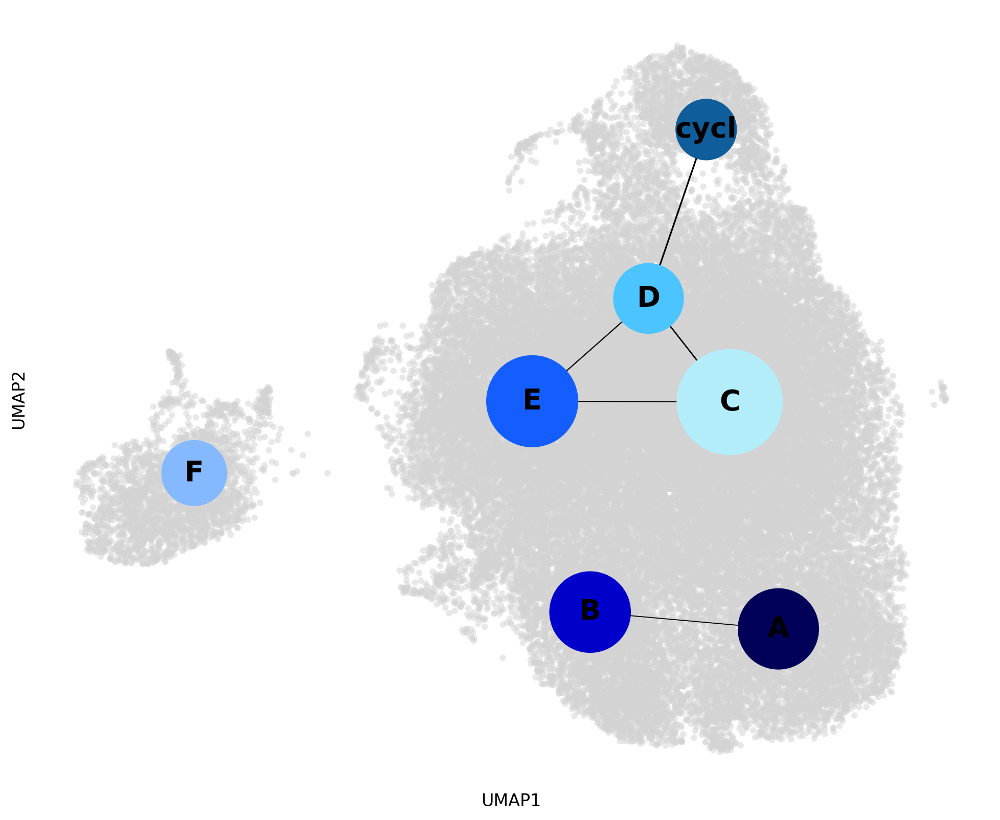

In [162]:
# Define threshold
thr = 0.15

# Define PAGA positions based on the UMAP layout -
# for each cluster we use the mean of the UMAP positions from the cells in that cluster
pos = pd.DataFrame(adata_sub.obsm["X_umap"], index=adata_sub.obs_names)
pos["group"] = adata_sub.obs[adata_sub.uns["paga"]["groups"]]
pos = pos.groupby("group").mean()

# Adjust the figure size
fig, ax = plt.subplots(figsize=(12, 10))  # Increase the figure size

# Plot UMAP in the background on the same ax
sc.pl.umap(adata_sub, ax=ax, show=False, size=80, alpha=0.5)

# Plot PAGA on top of the UMAP on the same ax
sc.pl.paga(
    adata_sub,
    color="MG_type_fine_LETTER",
    threshold=thr,
    node_size_scale=20,
    edge_width_scale=0.5,
    pos=pos.values,
    random_state=0,
    ax=ax,
    frameon=False,
    fontsize=20,  # Adjust the fontsize for the node labels
    save=time+'PAGA_MG_extended.png'
)

# Show the plot
plt.show()

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:175: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_tidy.mask(~obs_bool).groupby(level=0).mean().fillna(0)
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided 

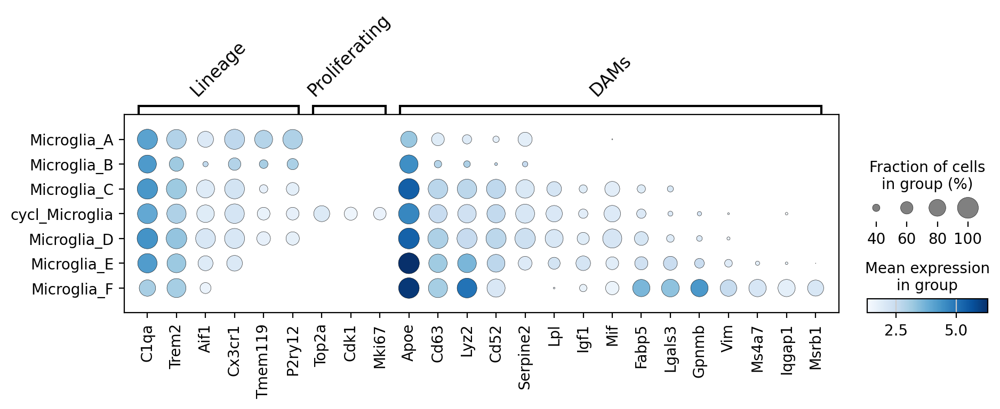

In [8]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Lineage': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'Tmem119', 'P2ry12'],
    'Proliferating': ['Top2a', 'Cdk1', 'Mki67'],
    'DAMs': ['Apoe', 'Cd63', 'Lyz2', 'Cd52', 'Serpine2', 'Lpl', 'Igf1', 'Mif', 'Fabp5', 
             'Lgals3', 'Gpnmb', 'Vim', 'Ms4a7', 'Iqgap1', 'Msrb1'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group
    
# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='Blues',  # Choose a color map
    show=False,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1,
)

# Save the plot
plt.savefig('./figures/dot_plot_MG_types_UPDATED.png')

# Show the plot
plt.show()

In [99]:
sc.tl.dendrogram(adata_sub, 'MG_type_fine_NEW')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_MG_type_fine_NEW']`


In [100]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_sub, groupby='MG_type_fine_NEW', key_added='rank_genes_MG_type_fine_NEW', 
                        method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_MG_type_fine_NEW']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:452: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (


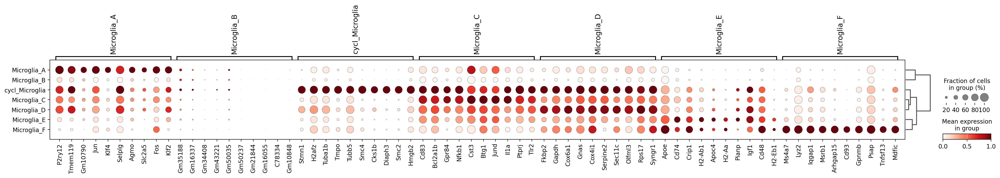

In [101]:
sc.pl.rank_genes_groups_dotplot(adata_sub, n_genes=10, key='rank_genes_MG_type_fine_NEW',
                               standard_scale='var') #save='_scVI_ctrl_annotated.pdf')

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt


# Define the custom blue colormap
blue_colors = ['#f0f8ff', '#d6e6f5', '#adcfeb', '#4b9ce7', '#1072ff', '#0057d4', '#003f99', '#00204d']
custom_blues = LinearSegmentedColormap.from_list('CustomBlues', blue_colors, N=512)

# Create a gradient for visualization
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))

# Plot the custom colormap
fig, ax = plt.subplots(figsize=(6, 2))

# Show the gradient with the custom colormap
ax.imshow(gradient, aspect='auto', cmap=custom_blues)

# Turn off the axes for a clean look
ax.set_axis_off()

# Show the plot
plt.show()

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

# Define the custom blue colormap
blue_colors = ['#f0f8ff', '#d6e6f5', '#adcfeb', '#4b9ce7', '#1072ff', '#0057d4', '#003f99', '#00204d']
custom_blues = LinearSegmentedColormap.from_list('CustomBlues', blue_colors, N=512)

# Use the custom colormap in the plot
sc.pl.embedding_density(adata_all_subsample, basis='umap', key='umap_density_lesion_status', 
                        color_map=custom_blues, wspace=0.1, bg_dotsize=8, frameon=False, 
                        ncols=3, save='_distribution_downscaling_all_NEW_BLUES.png')

In [ ]:
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=['Top2a', 'Cdk1', 'Mki67'],
    frameon=False,
    ncols=4,
    s=5,
    use_raw=False,
    color_map=custom_blues,
    layer='log1p_norm',
    #save=time+'_mm_sysVI_MG_genes3.pdf'
)

In [164]:
adata_sub.write_h5ad('./adata_MG_fine_type_WORKING.h5ad')
adata_sub

AnnData object with n_obs × n_vars = 52981 × 19308
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'S_score', 'G2M_score', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'cluster_annotation', 'cell_leiden_annotated', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2', 'leiden_MG_r0.5', 'leiden_MG_r0.7', 'leiden_MG_r1', 'leiden_MG_r0.3', 'minimal_treatment_map', 'MG_type_fine', 'MG_leiden_annotated', 'NEW_treatment_map', 'individual_lesion_condition', 'MG_type_broad', 'MG_type_fine_reduced', 'MG_type_fine_NEW', 'MG_type_fine_NEW_NUMBERED', 'MG_type_fine_NUMBERED', 'MG_type_fine_LETTER'
   

# New barcharts

In [11]:
# Unique values in the 'condition' column
unique_conditions = adata.obs['lesion_status'].unique()
for condition in unique_conditions:
    print(condition)

LPC_demyelination_7d
LPC_saline
Cuprizone_demyelination_5w
Cuprizone_baseline_adams
LPC_demyelination_5d
LPC_remyelination_28d
LPC_no_lesion
LPC_demyelination_14d
Cuprizone_remyelination_4+3w
Cuprizone_demyelination_4w
Cuprizone_baseline


In [5]:
status_updated = {
    'LPC_demyelination_7d': 'LPC_demyel',
    'LPC_saline': 'LPC_baseline',
    'Cuprizone_demyelination_5w': 'Cupr_demyel',
    'Cuprizone_baseline_adams': 'Cupr_baseline',
    'LPC_demyelination_5d': 'LPC_demyel',
    'LPC_remyelination_28d': 'LPC_remyel',
    'LPC_no_lesion': 'LPC_baseline',
    'LPC_demyelination_14d': 'LPC_mid_remyel',
    'Cuprizone_remyelination_4+3w': 'Cupr_remyel',
    'Cuprizone_demyelination_4w': 'Cupr_demyel',
    'Cuprizone_baseline': 'Cupr_baseline'
}

adata.obs['lesion_status'] = adata.obs['lesion_status'].map(status_updated)

In [9]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata.obs.groupby(['lesion_status', 'MG_type_fine_NEW']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='MG_type_fine_NEW', columns='lesion_status', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/836680.1.long/ipykernel_891588/2959023363.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata.obs.groupby(['lesion_status', 'MG_type_fine_NEW']).size().reset_index(name='cell_count')


MG_type_fine_NEW,BAMs,Microglia_A,Microglia_B,Microglia_C,Microglia_D,cycl_Microglia
lesion_status,,,,,,
Cupr_baseline,1.153064,42.459869,41.080714,11.914990,3.255709,0.135655
Cupr_demyel,0.509362,17.318316,15.115862,24.456561,36.171892,6.428008
Cupr_remyel,0.696749,9.477992,31.132493,38.099978,20.349480,0.243309
LPC_baseline,0.929152,24.274100,65.505226,5.342625,3.368177,0.580720
LPC_demyel,14.180121,5.965117,11.353174,21.921805,33.378720,13.201063
LPC_mid_remyel,3.510896,4.373487,9.927361,19.915254,60.351090,1.921913
LPC_remyel,2.390585,3.199706,26.958441,30.746598,36.557558,0.147113


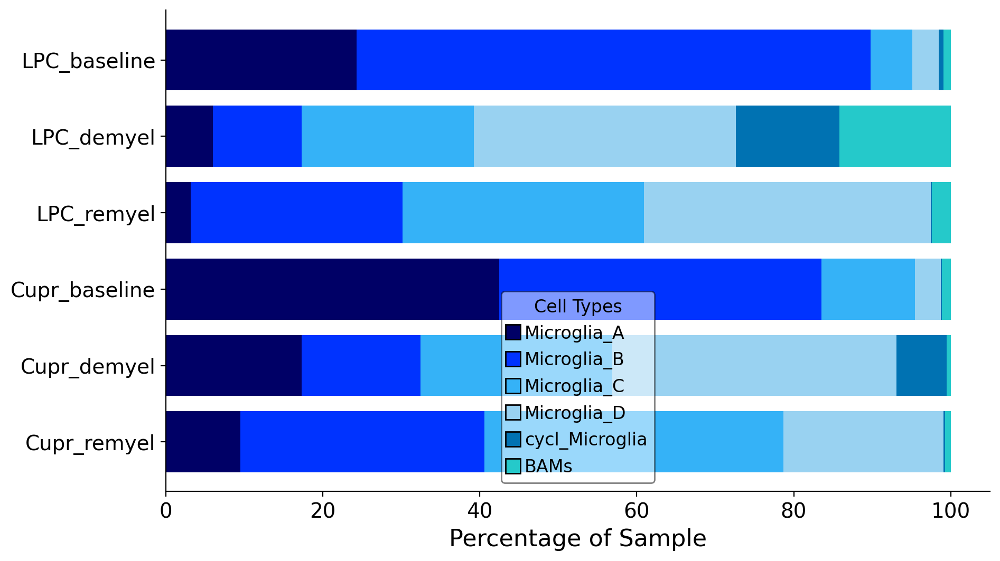

In [10]:
# Define the desired order of treatments and cell types
desired_treatments_order = ['LPC_baseline', 'LPC_demyel', 'LPC_mid_remyel', 'LPC_remyel',
                            'Cupr_baseline', 'Cupr_demyel', 'Cupr_remyel']
    
desired_cell_types_order = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'Microglia_D', 'cycl_Microglia', 'BAMs']

# Reorder the columns and the index of the percent_counts DataFrame
percent_counts_reordered = percent_counts_transposed[desired_cell_types_order].reindex(desired_treatments_order)

# Reorder the columns of the DataFrame with the 'other' category included
desired_cell_types_order_updated = ['Microglia_A', 'Microglia_B', 'Microglia_C', 'Microglia_D', 'cycl_Microglia', 'BAMs']

# Remove the specific row from the DataFrame
percent_counts_reordered.drop(index='LPC_mid_remyel', inplace=True)

#Rename index
percent_counts_reordered.rename(index={'LPC_mid_remyel': 'LPC_mid_remyel'}, inplace=True)

percent_counts_reordered = percent_counts_reordered[desired_cell_types_order_updated]

# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'BAMs': '#25c9ca',       # Cyan-Blue
    'cycl_Microglia': '#0072B2',  # Deep Blue
    'Microglia_A': '#000066',     # Strong Blue
    'Microglia_B': '#0033ff',     # Sky Blue
    'Microglia_C': '#35b2f7',     # Light Blue
    'Microglia_D': '#99d2f1'      # Pale Blue
}

# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_reordered.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Create legend with transparency
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_reordered.columns]
legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower center', fontsize=12, title='Cell Types')

# Set transparency of the legend
legend.get_frame().set_alpha(0.5)  # Set alpha value for transparency (0.5 makes it semi-transparent)

# Optionally, add a border color for contrast
legend.get_frame().set_edgecolor('black')  # Set border color of the legend

# Save the plot as a PNG file
plt.savefig('./sysVI_mm_MG_figures/MM_MG_cell_types_barh.png', bbox_inches='tight', dpi=300)  # Increase DPI for higher resolution

# Show the plot
plt.show()

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


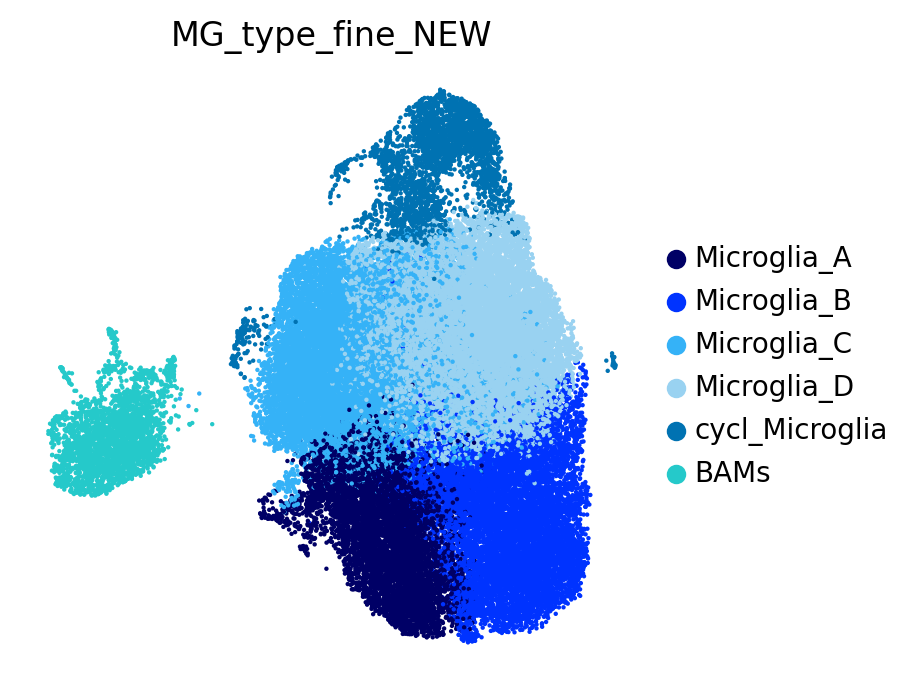

In [67]:
custom_colors = {
    'BAMs': '#25c9ca',       # Cyan-Blue
    'cycl_Microglia': '#0072B2',  # Deep Blue
    'Microglia_A': '#000066',     # Strong Blue
    'Microglia_B': '#0033ff',     # Sky Blue
    'Microglia_C': '#35b2f7',     # Light Blue
    'Microglia_D': '#99d2f1'      # Pale Blue
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata, color=['MG_type_fine_NEW'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=custom_colors,
           legend_fontweight= 'bold', frameon= False, s=10, 
           legend_fontoutline=1, save=time+'_annotated_cell_types_NEW_BLUES.pdf' )

# MAKE DOT PLOT

## Dot plot troubleshooting genes??

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:175: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_tidy.mask(~obs_bool).groupby(level=0).mean().fillna(0)
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormappi

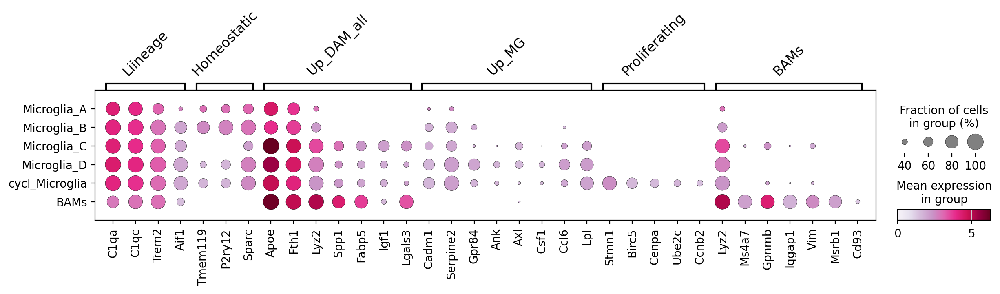

In [121]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Liineage': ['C1qa', 'C1qc', 'Trem2', 'Aif1'],
    'Homeostatic': ['Tmem119', 'P2ry12', 'Sparc'],
    'Up_DAM_all': ['Apoe', 'Fth1', 'Lyz2', 'Spp1', 'Fabp5', 'Igf1', 'Lgals3'], 
    'Up_MG': ['Cadm1', 'Serpine2', 'Gpr84', 'Ank', 'Axl', 'Csf1', 'Ccl6', 'Lpl'],
    'Proliferating': ['Stmn1', 'Birc5', 'Cenpa', 'Ube2c','Ccnb2'],
    'BAMs': ['Lyz2', 'Ms4a7', 'Gpnmb', 'Iqgap1', 'Vim', 'Msrb1', 'Cd93'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group
    
# Plot the dotplot with the corrected parameters
sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='PuRd',  # Choose a color map
    show=True,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1
)

In [125]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata, groupby='MG_type_fine_NEW', key_added='rank_genes_MG_type_fine_NEW', 
                        method='t-test_overestim_var', use_raw=False)

ranking genes
    finished: added to `.uns['rank_genes_MG_type_fine_NEW']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_MG_type_fine_NEW']`


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False i

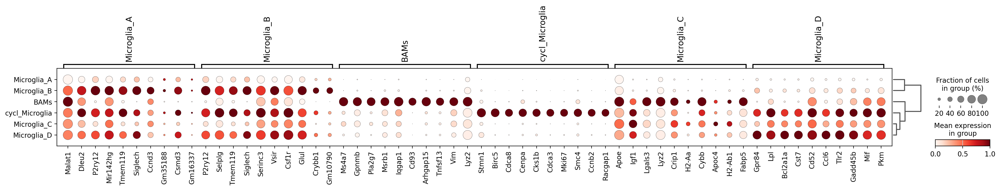

In [126]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, key='rank_genes_MG_type_fine_NEW',
                               standard_scale='var') #save='_scVI_ctrl_annotated.pdf')

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:175: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_tidy.mask(~obs_bool).groupby(level=0).mean().fillna(0)
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/cell2cell/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormappi

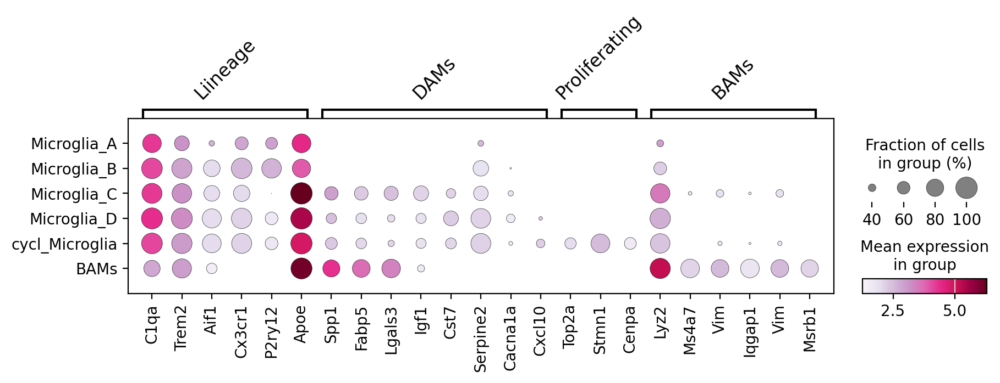

In [132]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Liineage': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'P2ry12', 'Apoe'],
    'DAMs': ['Spp1', 'Fabp5', 'Lgals3', 'Igf1', 'Cst7', 'Serpine2', 'Cacna1a', 'Cxcl10'],
    'Proliferating': ['Top2a', 'Stmn1', 'Cenpa'],
    'BAMs': ['Lyz2', 'Ms4a7', 'Vim', 'Iqgap1', 'Vim', 'Msrb1'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group
    
# Plot the dotplot with the corrected parameters
sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='PuRd',  # Choose a color map
    show=True,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1
)

In [24]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

# Define the custom blue colormap
blue_colors = ['#f0f8ff', '#d6e6f5', '#adcfeb', '#4b9ce7', '#1072ff', '#0057d4', '#003f99', '#00204d']
custom_blues = LinearSegmentedColormap.from_list('CustomBlues', blue_colors, N=512)

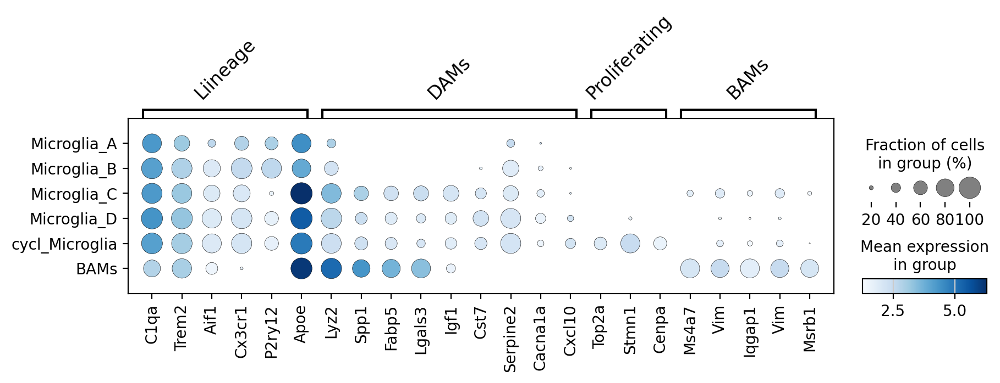

<Figure size 400x400 with 0 Axes>

In [32]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Liineage': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'P2ry12', 'Apoe'],
    'DAMs': ['Lyz2', 'Spp1', 'Fabp5', 'Lgals3', 'Igf1', 'Cst7', 'Serpine2', 'Cacna1a', 'Cxcl10'],
    'Proliferating': ['Top2a', 'Stmn1', 'Cenpa'],
    'BAMs': ['Ms4a7', 'Vim', 'Iqgap1', 'Vim', 'Msrb1'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group
    
# Plot the dotplot with the corrected parameters
sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='Blues',  # Choose a color map
    show=True,
    dot_min=0.1,
    mean_only_expressed=True,
    expression_cutoff=1
)

# Save the plot
plt.savefig('./sysVI_mm_MG_figures/dot_plot_MG_types_BLUES.pdf')

# Show the plot
plt.show()

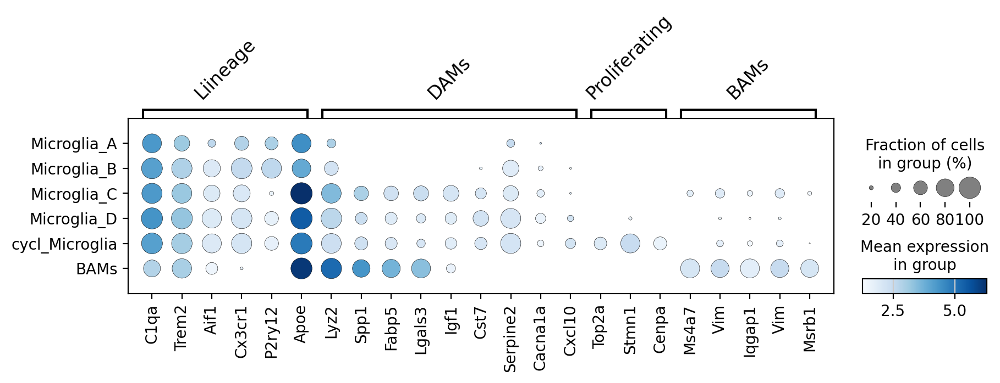

In [33]:
# Plot the dotplot with the corrected parameters
dotplot = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='Blues',  # Choose a color map
    show=False,  # Disable auto-showing to save properly
    dot_min=0.1,
    mean_only_expressed=True,
    expression_cutoff=1
)

# Save the plot before showing
plt.savefig('./sysVI_mm_MG_figures/dot_plot_MG_types_BLUES.pdf', bbox_inches='tight')

# Now, show the plot
plt.show()

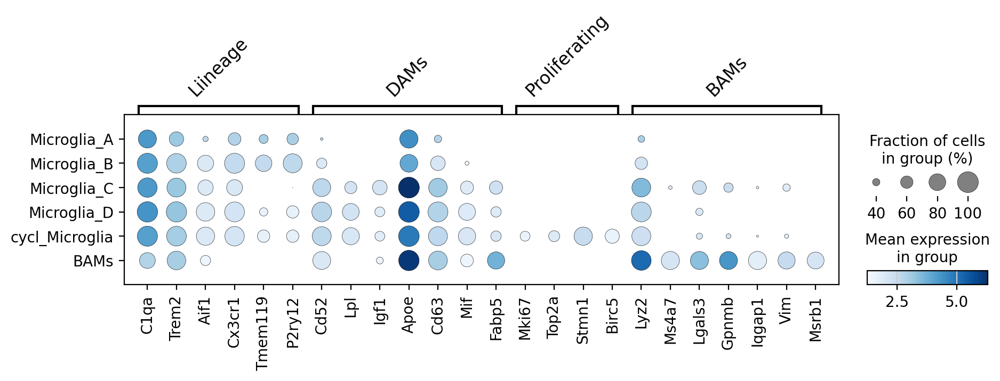

In [30]:
# Known marker genes with mouse gene names
marker_genes_mouse = {
    'Liineage': ['C1qa', 'Trem2', 'Aif1', 'Cx3cr1', 'Tmem119', 'P2ry12'],
    'DAMs': ['Cd52', 'Lpl', 'Igf1', 'Apoe', 'Cd63', 'Mif', 'Fabp5'],
    'Proliferating': ['Mki67', 'Top2a', 'Stmn1', 'Birc5'],
    'BAMs': ['Lyz2', 'Ms4a7', 'Lgals3', 'Gpnmb', 'Iqgap1', 'Vim', 'Msrb1']
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes_mouse = [gene for genes in marker_genes_mouse.values() for gene in genes]

# Correct var_group_positions based on marker_genes_mouse
var_group_positions_mouse = []
start = 0
for genes in marker_genes_mouse.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions_mouse.append((start, end))  # Add the start and end index to var_group_positions_mouse
    start = end + 1  # Update the start index for the next group
    
# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
    adata,
    groupby="MG_type_fine_NEW",
    var_names=all_genes_mouse,
    use_raw=False,
    log=False,
    layer='log1p_norm',
    dendrogram=False,
    var_group_positions=var_group_positions_mouse,
    var_group_labels=list(marker_genes_mouse.keys()),
    var_group_rotation=45,
    standard_scale=None,  # Set to None to disable standard scaling
    swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
    cmap='Blues',  # Choose a color map
    show=False,
    dot_min=0.2,
    mean_only_expressed=True,
    expression_cutoff=1,
)

# Save the plot
#plt.savefig('./sysVI_mm_MG_figures/dot_plot_MG_types.pdf')

# Show the plot
plt.show()